# Imports

In [1]:
from __future__ import division
from __future__ import print_function
from __future__ import absolute_import

import collections
from typing import Dict
from typing import Tuple
import pandas as pd
import numpy as np
import datetime
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
%matplotlib inline

In [3]:
import sys
sys.path.insert(0, '../src/')

import network_utils

In [105]:
matrix_edges = [[1, 2, +1, datetime.datetime(2017, 1, 1)],
                [2, 3, +1, datetime.datetime(2017, 1, 4)],
                [3, 1, +1, datetime.datetime(2017, 2, 5)],
                [1, 4, -1, datetime.datetime(2017, 2, 13)],
                [4, 3, -1, datetime.datetime(2017, 2, 24)],
                [-1, -1, -1, datetime.datetime(2017, 2, 28)]]
                # The last one is going to be ignored because fall into
                #   another period which is neglected.
sample_edge_list = pd.DataFrame(
    matrix_edges, columns=['source', 'target', 'weight', 'edge_date'])
g1 = nx.DiGraph()
g1.add_nodes_from([1, 2, 3])
g1.add_edge(1, 2)
g1.add_edge(2, 3)
g2 = nx.DiGraph()
g2.add_nodes_from([1, 3, 4])
g2.add_edge(3, 1)
g2.add_edge(1, 4)
g2.add_edge(4, 3)
expected = [g1, g2]
computed = network_utils.extract_graphs(
    edge_list=sample_edge_list, weeks=4, accumulated=True)

In [108]:
print(computed[0].nodes(), '\t', computed[0].edges())

[1, 2, 3] 	 [(1, 2), (2, 3)]


In [109]:
print(computed[1].nodes(), '\t', computed[1].edges())

[1, 2, 3, 4] 	 [(1, 2), (1, 4), (2, 3), (3, 1), (4, 3)]


In [31]:
i = 1
expected[i].nodes() == computed[i].nodes() and expected[i].edges() == computed[i].edges()

False

OutEdgeView([(1, 2), (2, 3)])

# Helper functions

In [6]:
def count_different_signed_edges(dgraph):
    different_signs = 0
    nodes = list(dgraph.nodes())
    for i in range(len(nodes)-1):
        for j in range(i+1, len(nodes)):
            if (dgraph.has_edge(nodes[i], nodes[j]) and
                dgraph.has_edge(nodes[j], nodes[i])):
                wij = dgraph.get_edge_data(
                    nodes[i], nodes[j])['weight']
                wji = dgraph.get_edge_data(
                    nodes[j], nodes[i])['weight']
                if np.sign(wij) != np.sign(wji):
                    different_signs += 1
    return different_signs

# Data loading

In [10]:
# Loads the csv file into a dataframe.
data = pd.read_csv('soc-sign-bitcoinotc.csv', header=None)

# Sets the names of the columns.
data.columns = ['source', 'target', 'weight', 'edge_date']

# Converts the datetime structure and sets in the dataframe.
converted_times = []
for row_index in range(len(data)):
    converted_times.append(
        datetime.datetime.fromtimestamp(data['time'][row_index]))
data['time'] = converted_times

# Sorts the data by time column.
data.sort_values(by='time', inplace=True)

In [11]:
data.head()

,source,target,weight,time
0,6,2,4,2010-11-08 10:45:11.728360
1,6,5,2,2010-11-08 10:45:41.533780
2,1,15,1,2010-11-08 11:05:40.390490
3,4,3,7,2010-11-08 11:41:17.369750
4,13,16,8,2010-11-08 14:10:54.447460


# Data basic analysis

In [12]:
data_len = len(data)
print('Data has {} #edges.\nIt spans from {} to {}.\n'
      'It has {} #nodes (unique) in total duration.'.format(
          data_len,
          min(data['time']).date(),
          max(data['time']).date(),
          len(set(data['source']).union(set(data['target'])))))

pos = len(np.where(data['weight'] > 0)[0])
neg = len(np.where(data['weight'] < 0)[0])
zer = len(np.where(data['weight'] == 0)[0])  # It should not be any zeros.
print('\nEdge (trust/distrust) over time:\n\t+:'
      ' {}({}%)\n\t-: {}({}%)\n\t0: {}({}%).'.format(
          pos, round(100*pos/data_len),
          neg, round(100*neg/data_len),
          zer, round(100*zer/data_len)))

Data has 35592 #edges.
It spans from 2010-11-08 to 2016-01-24.
It has 5881 #nodes (unique) in total duration.

Edge (trust/distrust) over time:
	+: 32029(90%)
	-: 3563(10%)
	0: 0(0%).


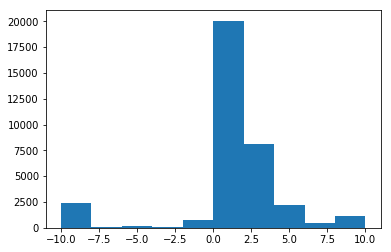

In [13]:
plt.hist(data['weight']);

# Extracting the networks

In [14]:
weeks = 4

start_date = min(data['time'])
end_date = max(data['time'])

directed_graphs = []
accumulated_directed_graphs = []
periods_num = int(np.floor((end_date - start_date).days / (weeks * 7)))
# For every period, we extract a directed weighted signed network.
for period_index in range(periods_num):
    period_start = (
        start_date + period_index * datetime.timedelta(weeks * 7))
    period_end = period_start + datetime.timedelta(weeks * 7)
    # Chooses the data only for this period.
    period_data = data[
        (data['time'] >= period_start) &
        (data['time'] < period_end)]
    directed_graph = nx.from_pandas_edgelist(
        period_data,
        source='source',
        target='target',
        edge_attr='weight',
        create_using=nx.DiGraph())
    directed_graphs.append(directed_graph)
    # Chooses the data until this period (accumulated).
    until_period_data = data[data['time'] < period_end]
    accumulated_directed_graph = nx.from_pandas_edgelist(
        until_period_data,
        source='source',
        target='target',
        edge_attr='weight',
        create_using=nx.DiGraph())
    accumulated_directed_graphs.append(accumulated_directed_graph)

# Plotting

#nodes: 30
#edges: 72
#edges/#nodes: 2.4


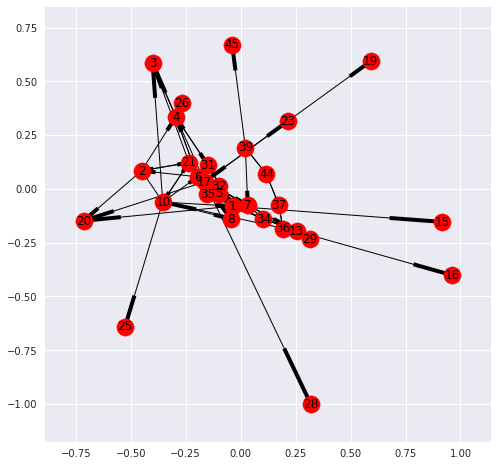





#nodes: 43
#edges: 76
#edges/#nodes: 1.7674418604651163


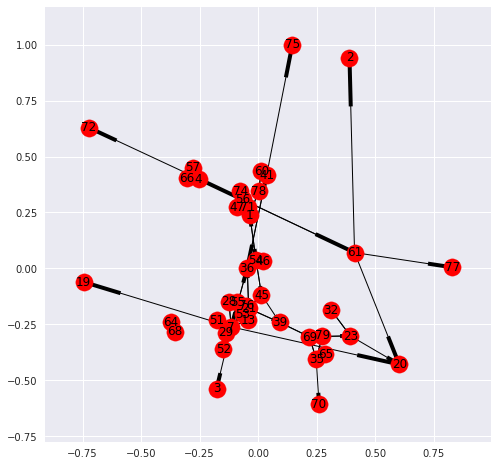





#nodes: 48
#edges: 89
#edges/#nodes: 1.8541666666666667


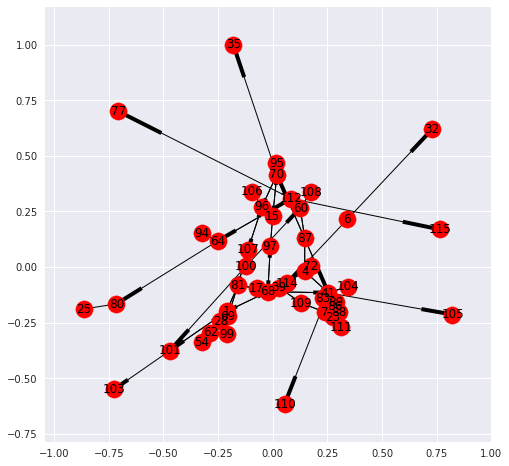





#nodes: 93
#edges: 243
#edges/#nodes: 2.6129032258064515


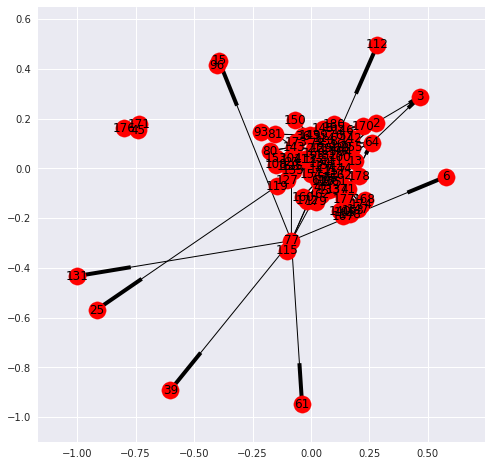





#nodes: 88
#edges: 175
#edges/#nodes: 1.9886363636363635


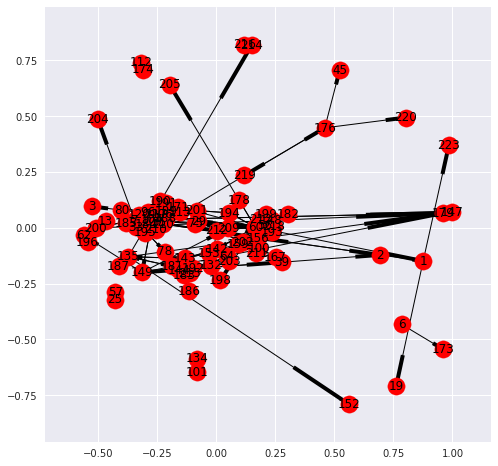





#nodes: 180
#edges: 433
#edges/#nodes: 2.4055555555555554


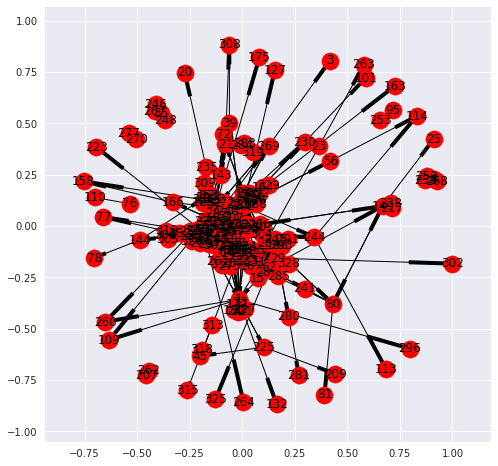





#nodes: 496
#edges: 1636
#edges/#nodes: 3.2983870967741935


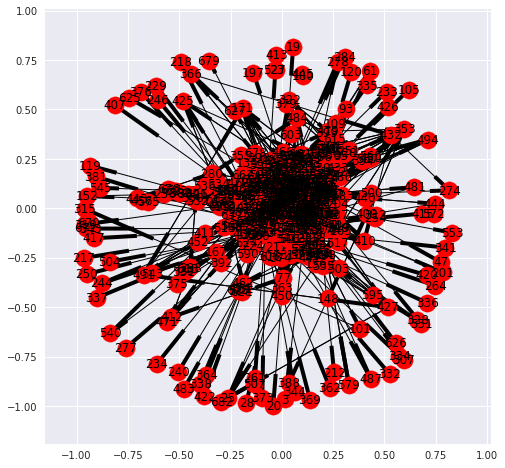





#nodes: 800
#edges: 2436
#edges/#nodes: 3.045


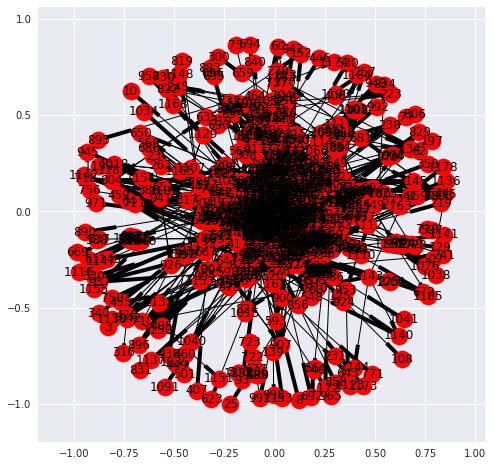





#nodes: 346
#edges: 777
#edges/#nodes: 2.245664739884393


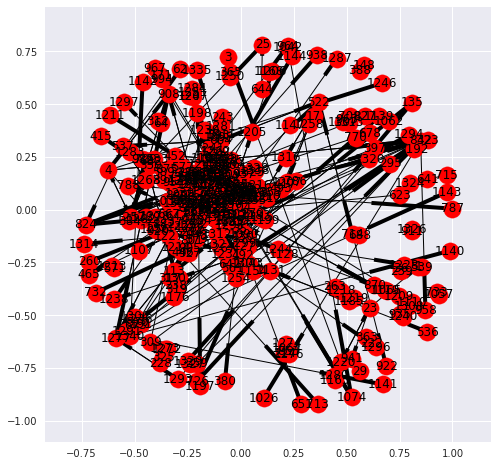





#nodes: 211
#edges: 477
#edges/#nodes: 2.2606635071090047


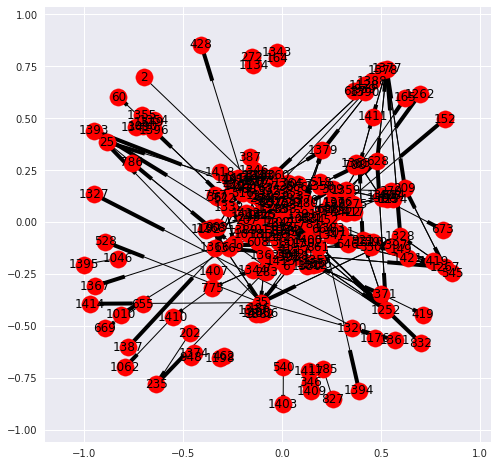





#nodes: 176
#edges: 342
#edges/#nodes: 1.9431818181818181


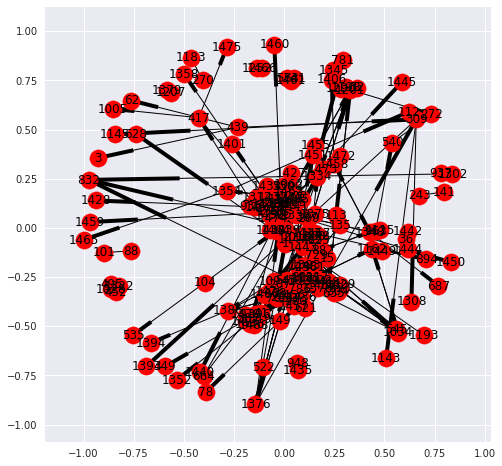





#nodes: 119
#edges: 233
#edges/#nodes: 1.9579831932773109


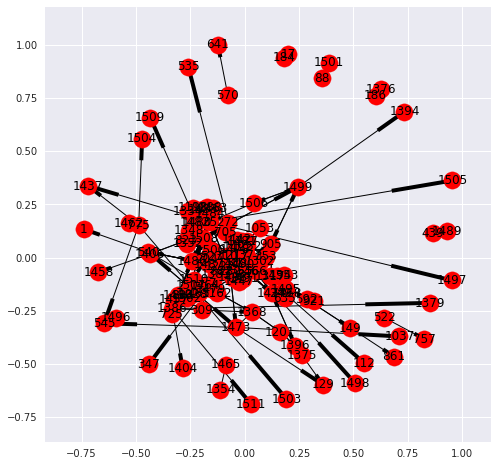





#nodes: 130
#edges: 238
#edges/#nodes: 1.8307692307692307


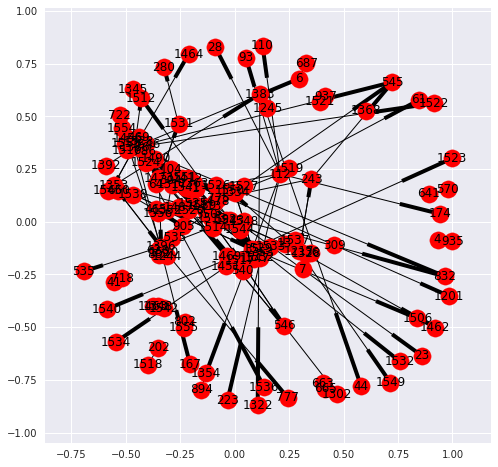





#nodes: 142
#edges: 303
#edges/#nodes: 2.1338028169014085


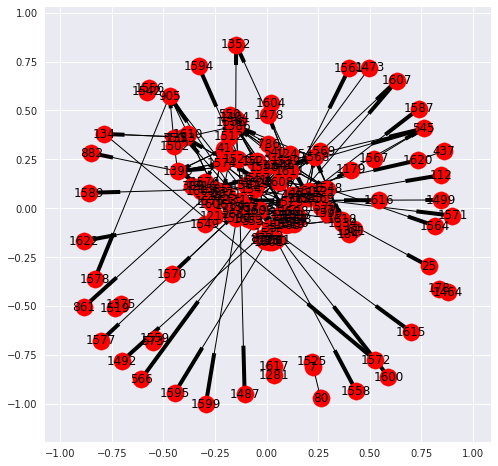





#nodes: 165
#edges: 393
#edges/#nodes: 2.381818181818182


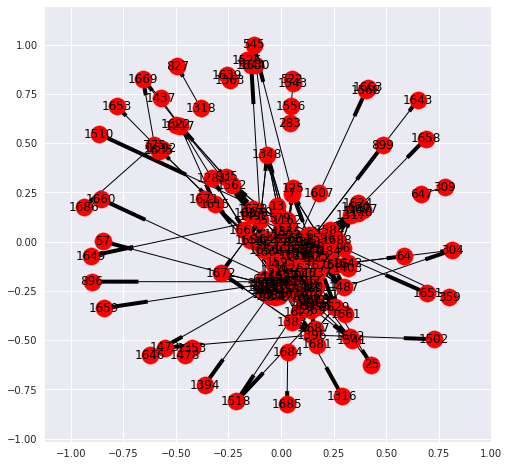





#nodes: 169
#edges: 346
#edges/#nodes: 2.0473372781065087


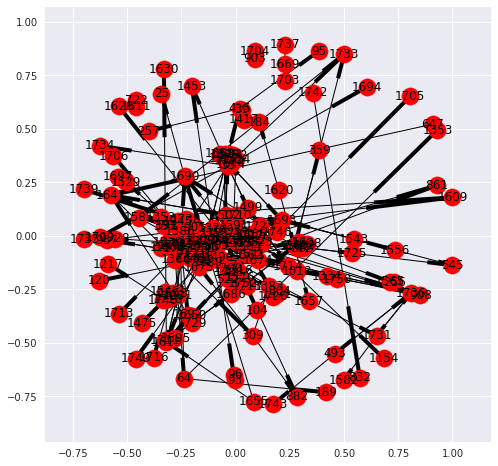





#nodes: 196
#edges: 476
#edges/#nodes: 2.4285714285714284


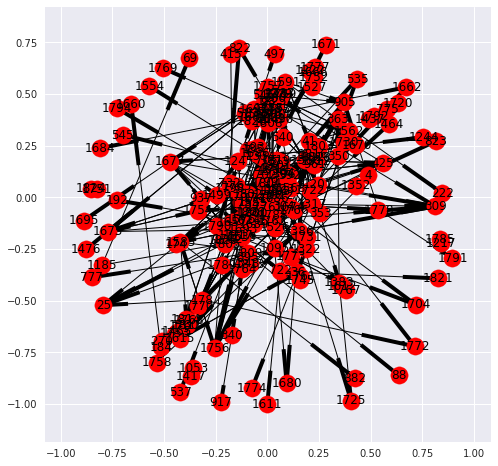





#nodes: 224
#edges: 515
#edges/#nodes: 2.299107142857143


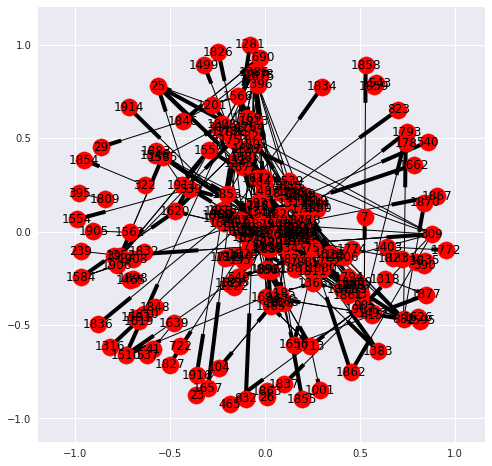





#nodes: 215
#edges: 505
#edges/#nodes: 2.3488372093023258


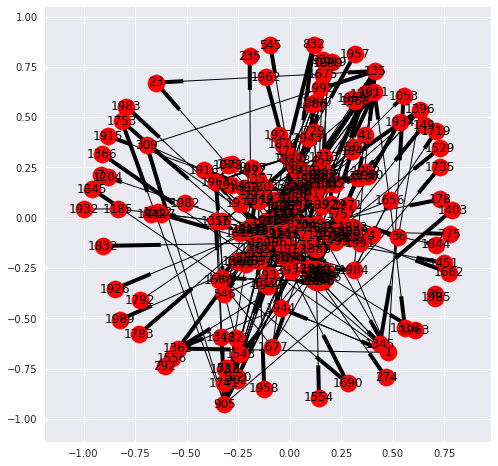





#nodes: 240
#edges: 496
#edges/#nodes: 2.066666666666667


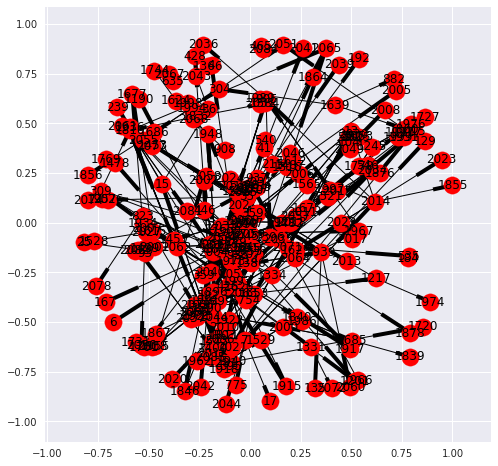





#nodes: 301
#edges: 704
#edges/#nodes: 2.338870431893688


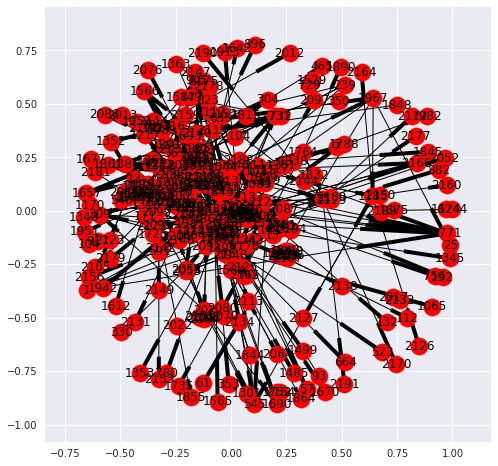





#nodes: 332
#edges: 765
#edges/#nodes: 2.3042168674698793


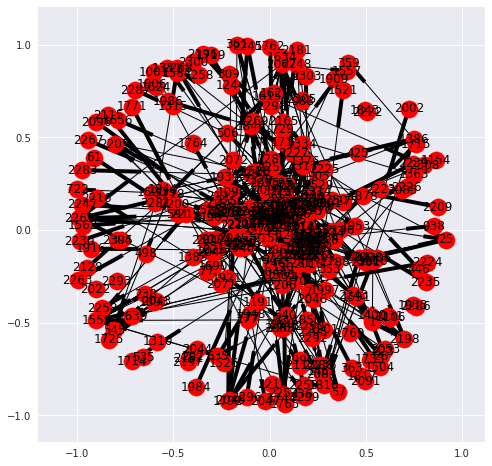





#nodes: 330
#edges: 794
#edges/#nodes: 2.4060606060606062


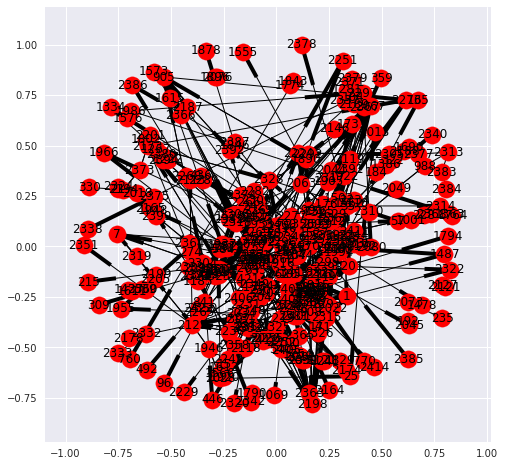





#nodes: 394
#edges: 922
#edges/#nodes: 2.3401015228426396


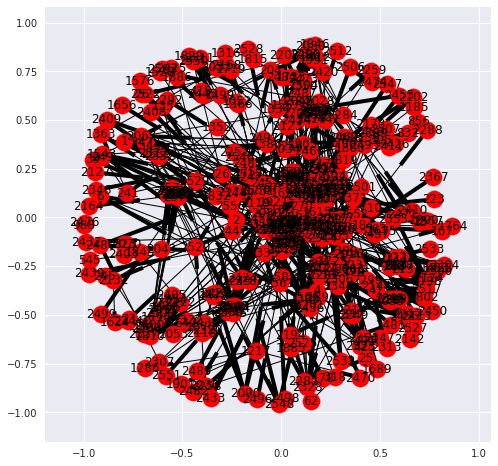





#nodes: 439
#edges: 1104
#edges/#nodes: 2.5148063781321186


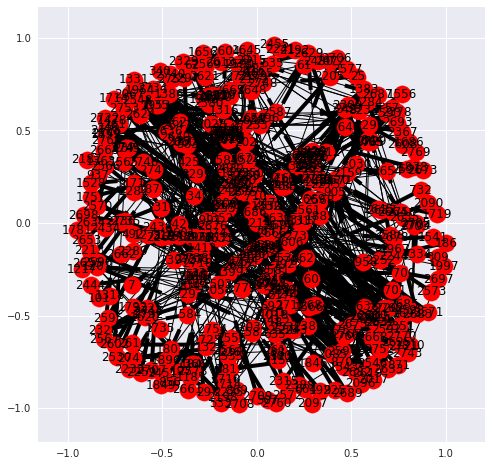





#nodes: 478
#edges: 927
#edges/#nodes: 1.9393305439330544


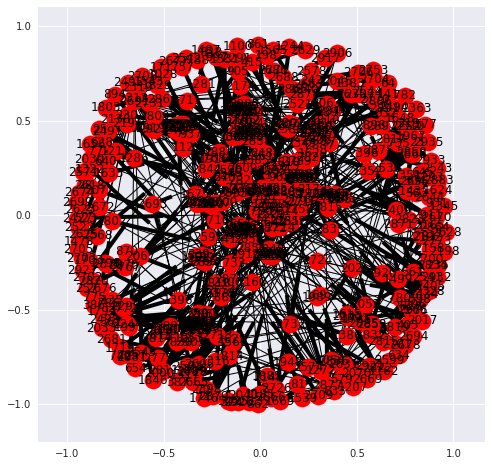





#nodes: 450
#edges: 933
#edges/#nodes: 2.0733333333333333


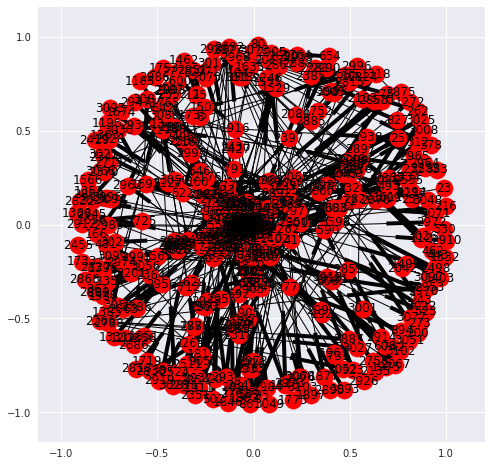





#nodes: 418
#edges: 910
#edges/#nodes: 2.1770334928229667


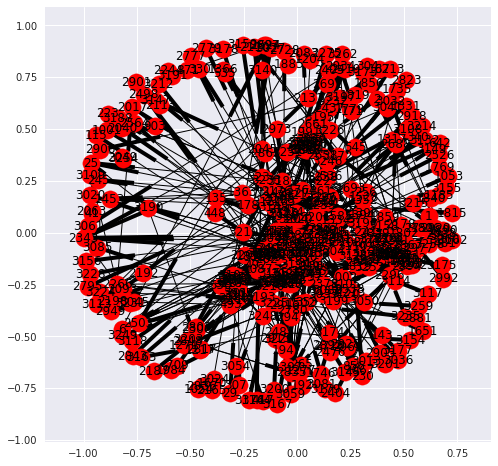





#nodes: 374
#edges: 803
#edges/#nodes: 2.1470588235294117


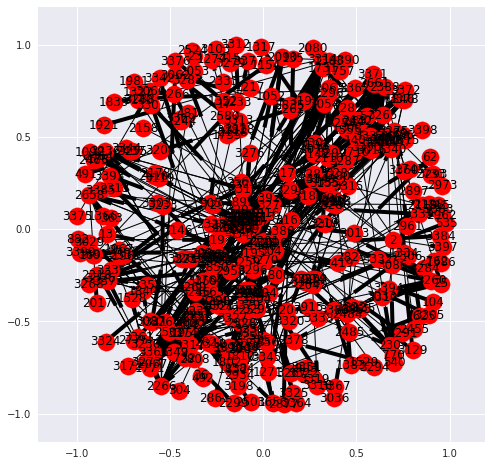





#nodes: 371
#edges: 757
#edges/#nodes: 2.0404312668463613


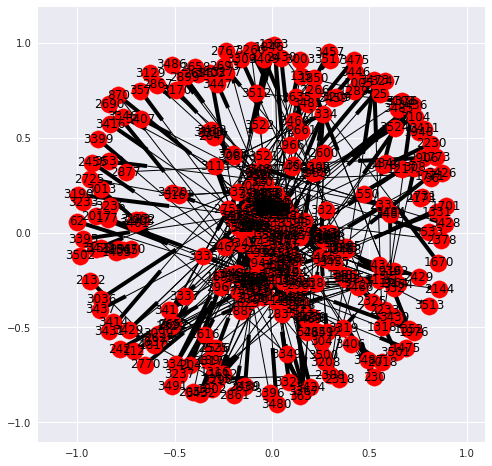





#nodes: 501
#edges: 1082
#edges/#nodes: 2.1596806387225547


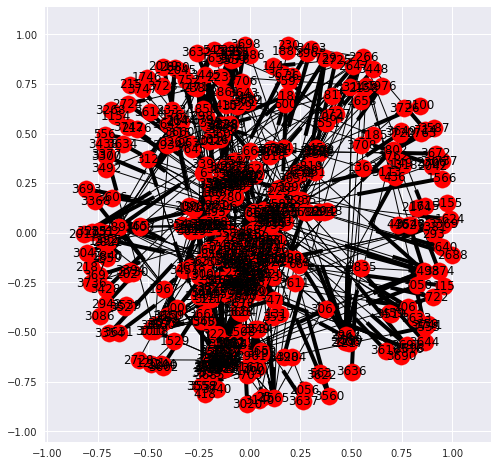





#nodes: 779
#edges: 1901
#edges/#nodes: 2.4403080872913994


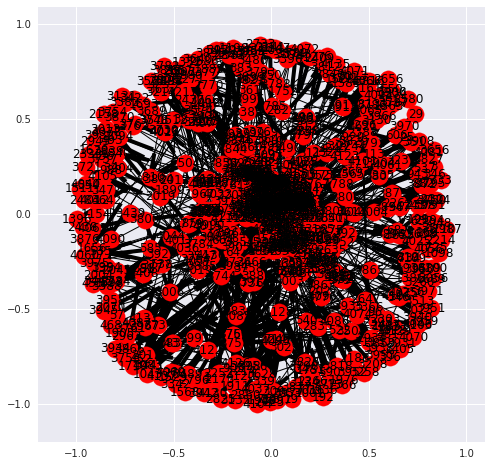





#nodes: 496
#edges: 1120
#edges/#nodes: 2.2580645161290325


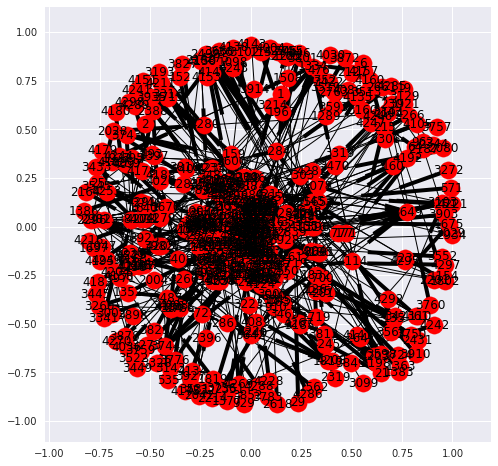





#nodes: 411
#edges: 911
#edges/#nodes: 2.21654501216545


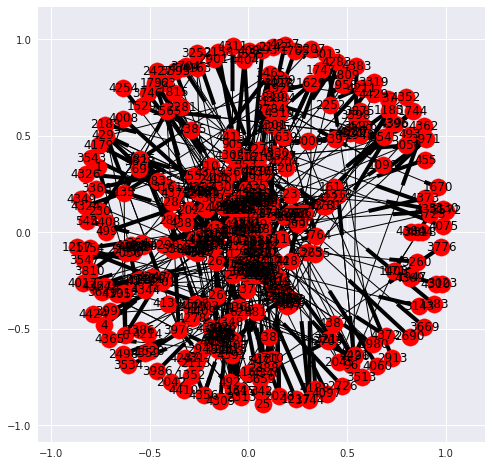





#nodes: 396
#edges: 855
#edges/#nodes: 2.159090909090909


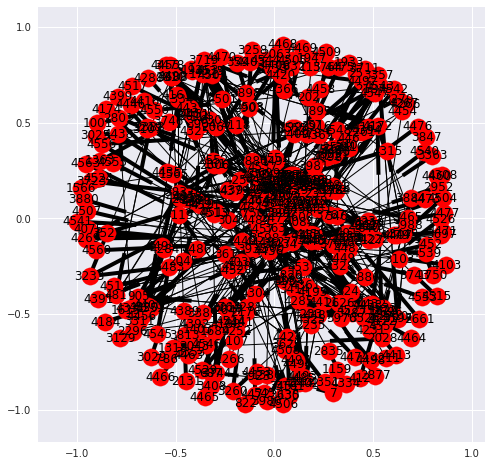





#nodes: 441
#edges: 1328
#edges/#nodes: 3.0113378684807257


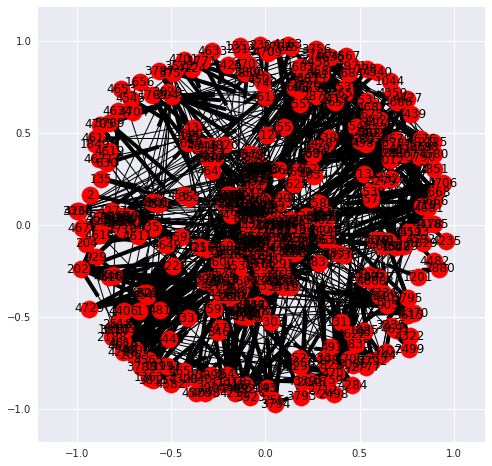





#nodes: 558
#edges: 1488
#edges/#nodes: 2.6666666666666665


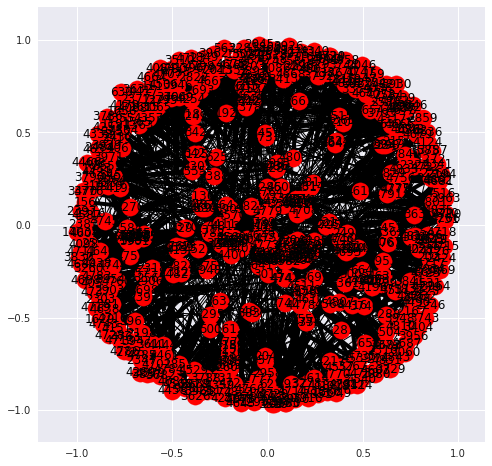





#nodes: 293
#edges: 526
#edges/#nodes: 1.795221843003413


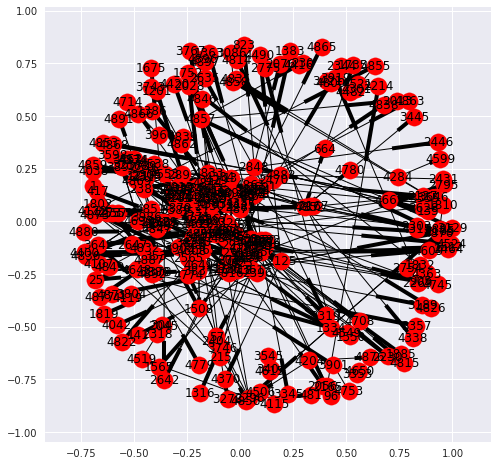





#nodes: 295
#edges: 555
#edges/#nodes: 1.88135593220339


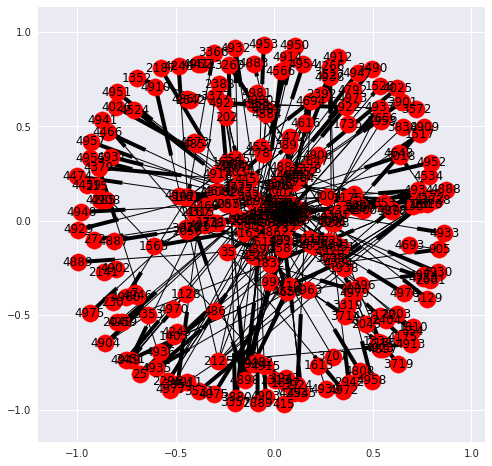





#nodes: 410
#edges: 925
#edges/#nodes: 2.2560975609756095


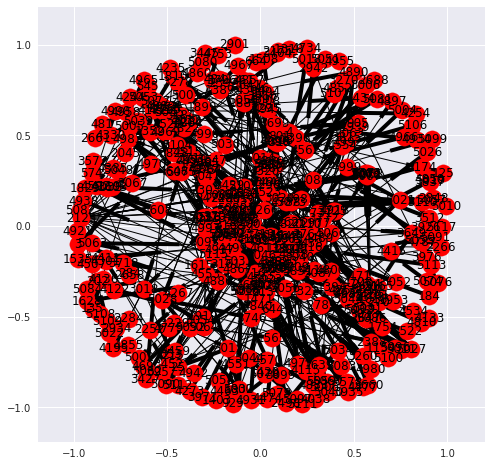





#nodes: 369
#edges: 715
#edges/#nodes: 1.937669376693767


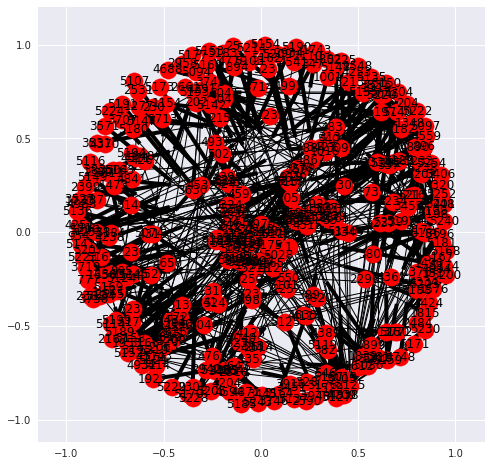





#nodes: 266
#edges: 430
#edges/#nodes: 1.6165413533834587


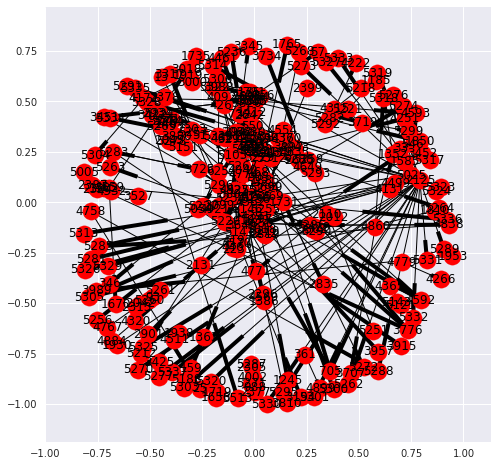





#nodes: 280
#edges: 493
#edges/#nodes: 1.7607142857142857


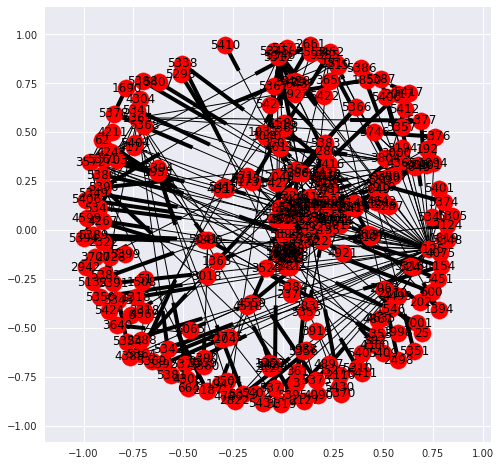





#nodes: 209
#edges: 321
#edges/#nodes: 1.5358851674641147


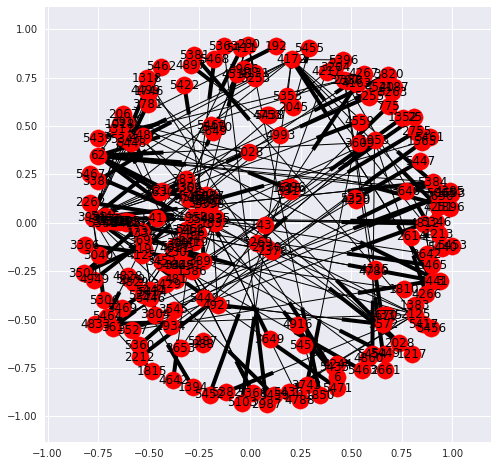





#nodes: 225
#edges: 424
#edges/#nodes: 1.8844444444444444


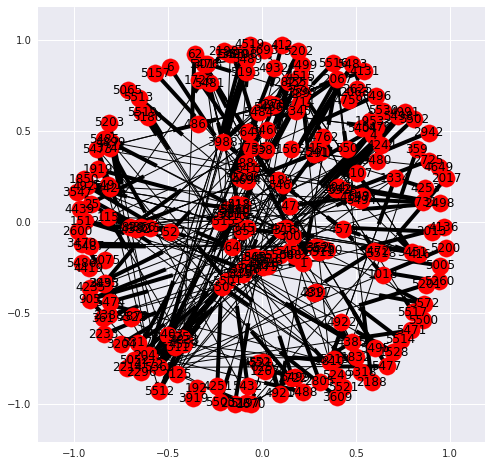





#nodes: 213
#edges: 439
#edges/#nodes: 2.0610328638497655


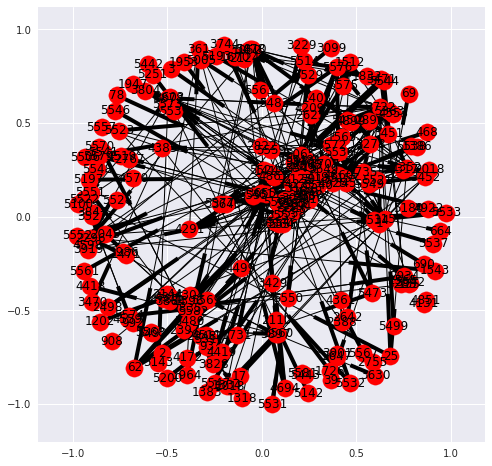





#nodes: 183
#edges: 334
#edges/#nodes: 1.825136612021858


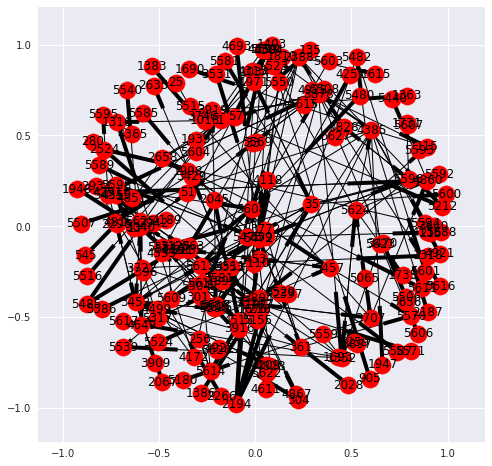





#nodes: 220
#edges: 358
#edges/#nodes: 1.6272727272727272


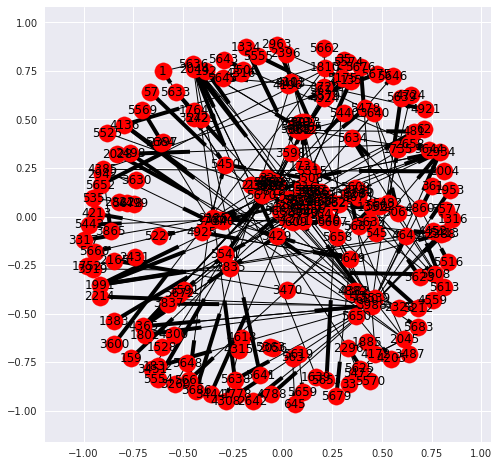





#nodes: 194
#edges: 314
#edges/#nodes: 1.6185567010309279


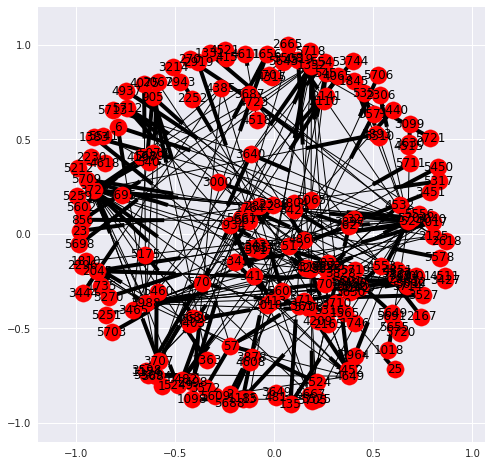





#nodes: 219
#edges: 361
#edges/#nodes: 1.6484018264840183


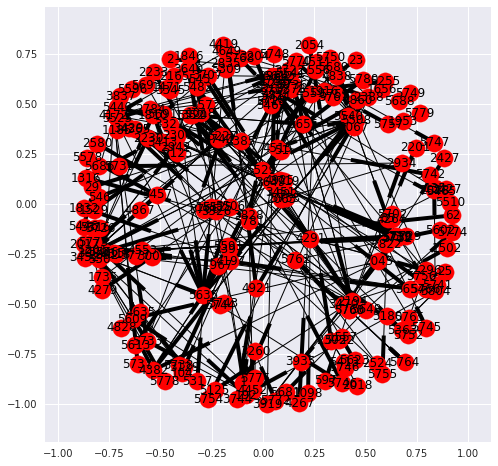





#nodes: 141
#edges: 193
#edges/#nodes: 1.3687943262411348


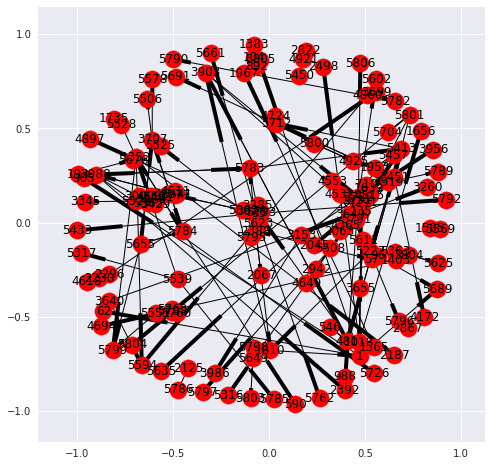





#nodes: 131
#edges: 212
#edges/#nodes: 1.618320610687023


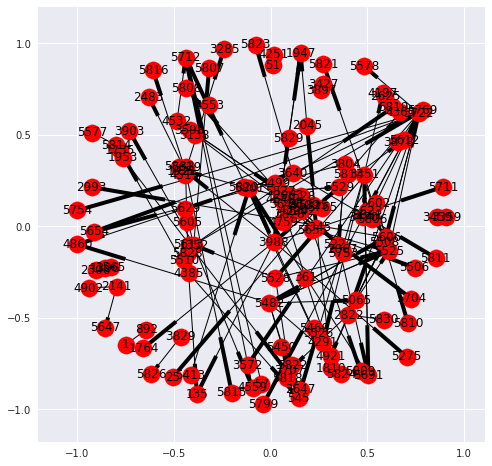





#nodes: 134
#edges: 198
#edges/#nodes: 1.4776119402985075


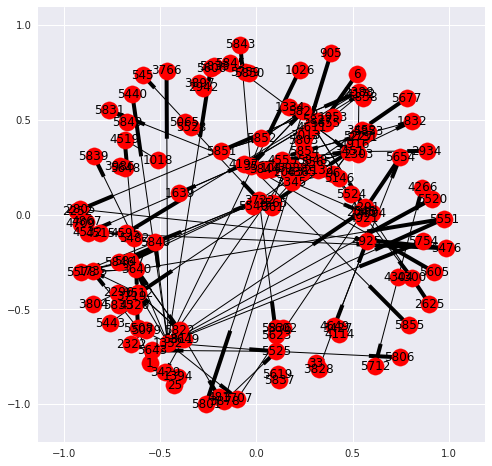





#nodes: 100
#edges: 136
#edges/#nodes: 1.36


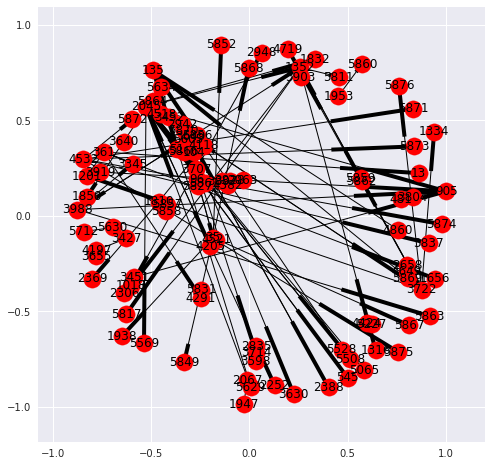





#nodes: 126
#edges: 170
#edges/#nodes: 1.3492063492063493


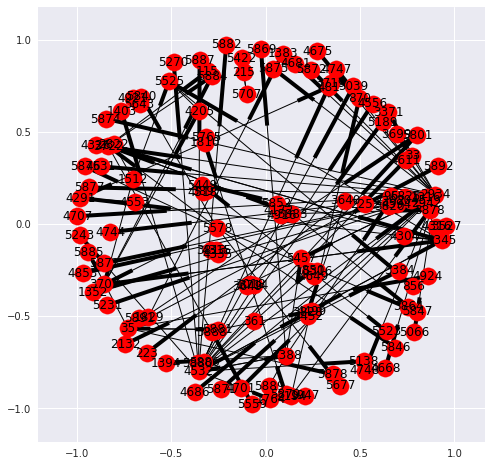





#nodes: 113
#edges: 120
#edges/#nodes: 1.0619469026548674


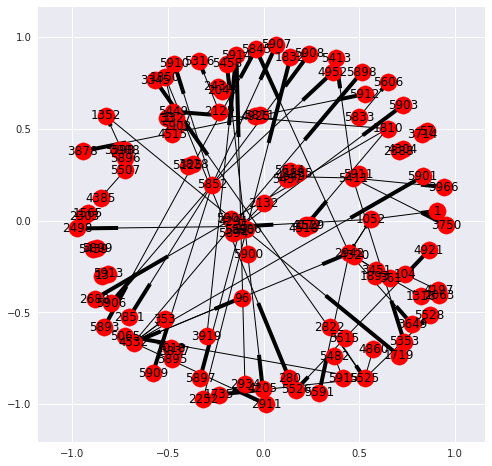





#nodes: 59
#edges: 83
#edges/#nodes: 1.4067796610169492


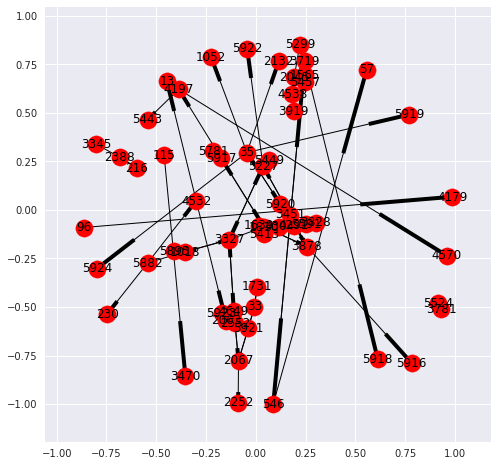





#nodes: 70
#edges: 79
#edges/#nodes: 1.1285714285714286


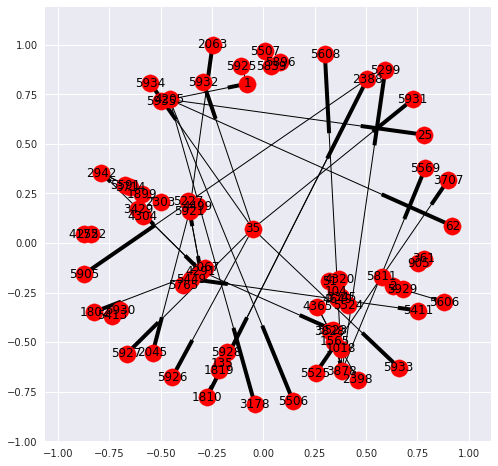





#nodes: 102
#edges: 145
#edges/#nodes: 1.4215686274509804


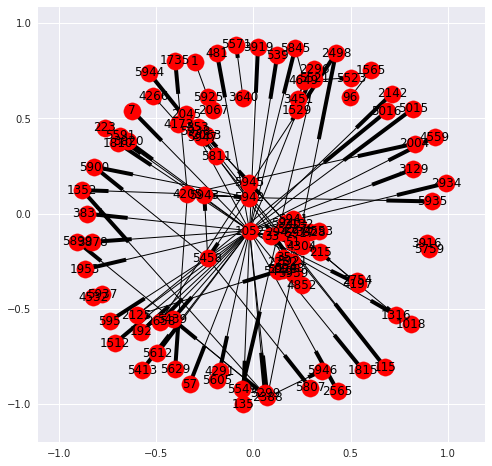





#nodes: 75
#edges: 107
#edges/#nodes: 1.4266666666666667


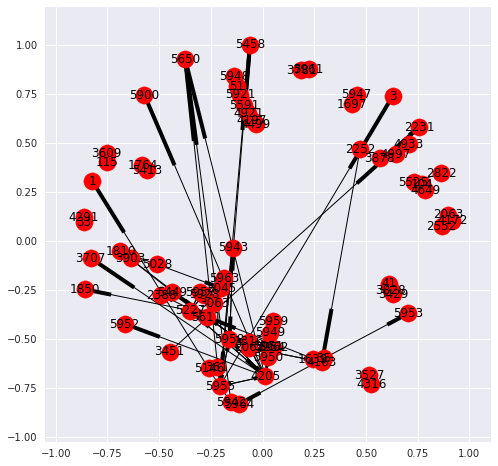





#nodes: 38
#edges: 48
#edges/#nodes: 1.263157894736842


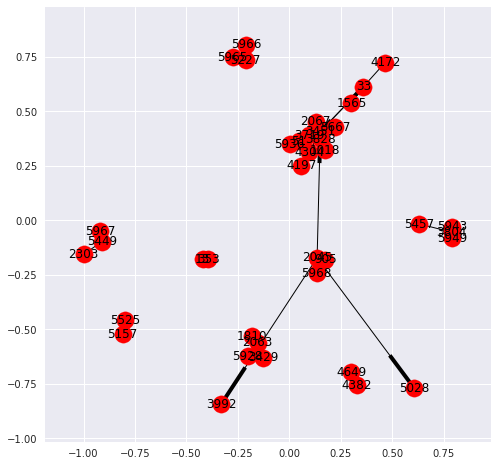





#nodes: 68
#edges: 77
#edges/#nodes: 1.1323529411764706


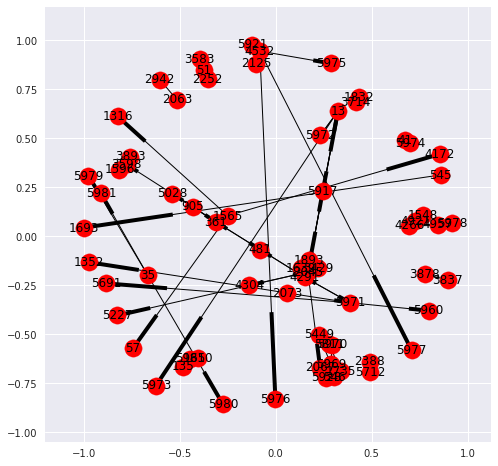





#nodes: 55
#edges: 81
#edges/#nodes: 1.4727272727272727


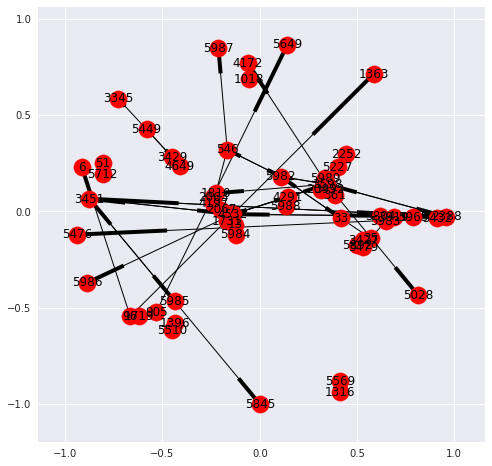





#nodes: 32
#edges: 41
#edges/#nodes: 1.28125


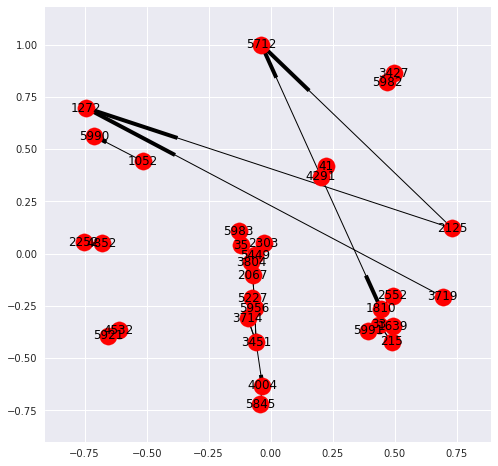





#nodes: 27
#edges: 33
#edges/#nodes: 1.2222222222222223


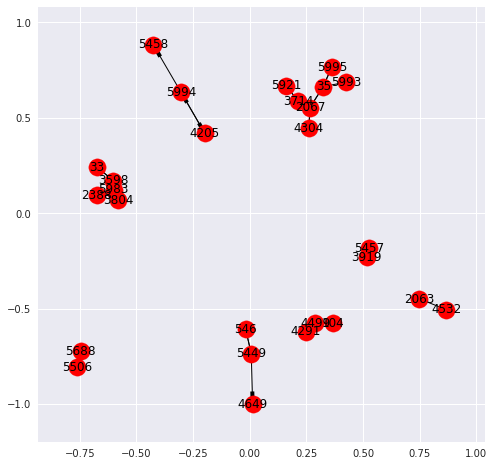





#nodes: 27
#edges: 27
#edges/#nodes: 1.0


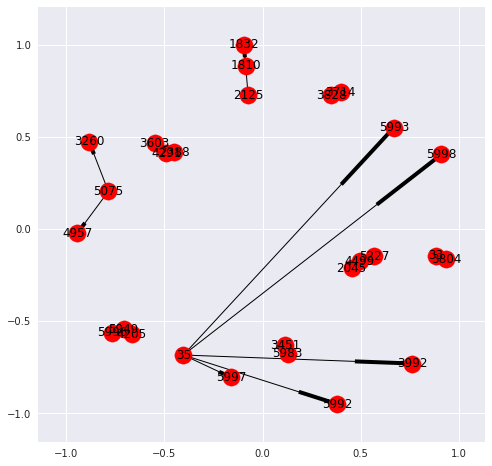





#nodes: 32
#edges: 39
#edges/#nodes: 1.21875


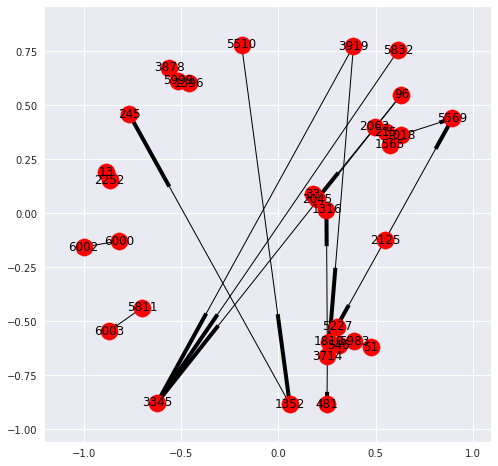

In [16]:
sns.set(rc={'figure.figsize':(8, 8)})
for directed_graph in directed_graphs:
    n = len(directed_graph.nodes())
    e = len(directed_graph.edges())
    print(
        '#nodes: {}\n#edges: {}\n#edges/#nodes: {}'
        .format(n, e, e/n))
    nx.draw_networkx(directed_graph)
    plt.show()
    print('\n\n\n')

#nodes: 30
#edges: 72
#edges/#nodes: 2.4


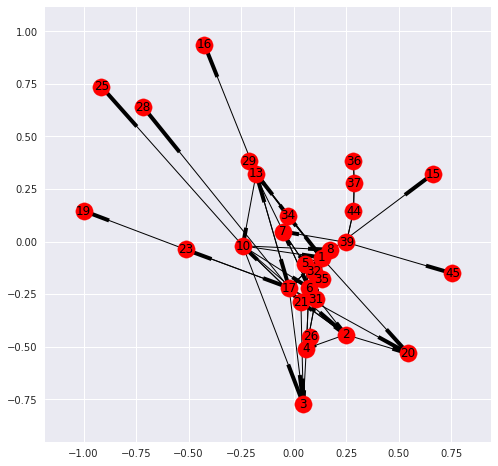





#nodes: 56
#edges: 148
#edges/#nodes: 2.642857142857143


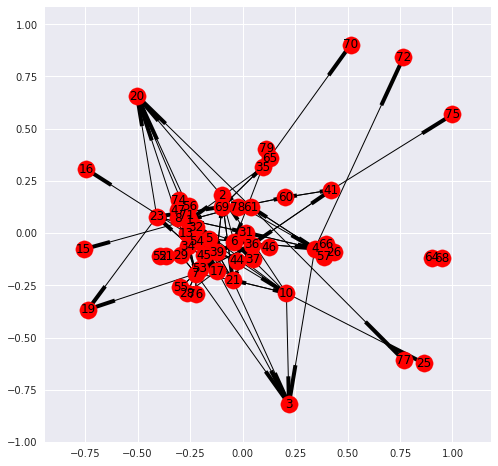





#nodes: 83
#edges: 237
#edges/#nodes: 2.855421686746988


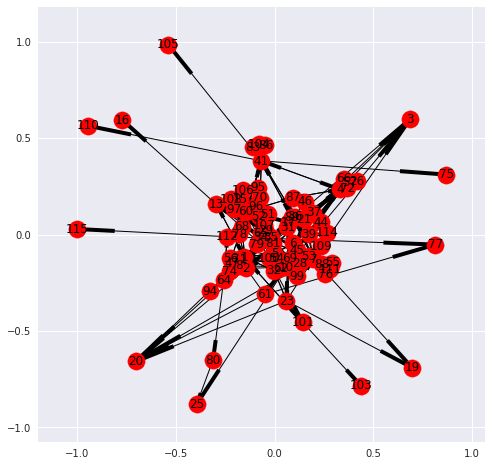





#nodes: 137
#edges: 480
#edges/#nodes: 3.5036496350364965


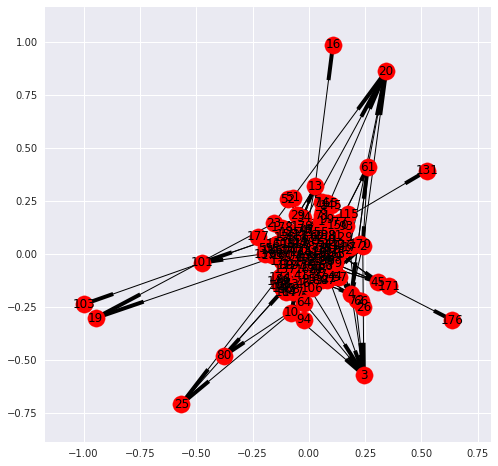





#nodes: 179
#edges: 655
#edges/#nodes: 3.659217877094972


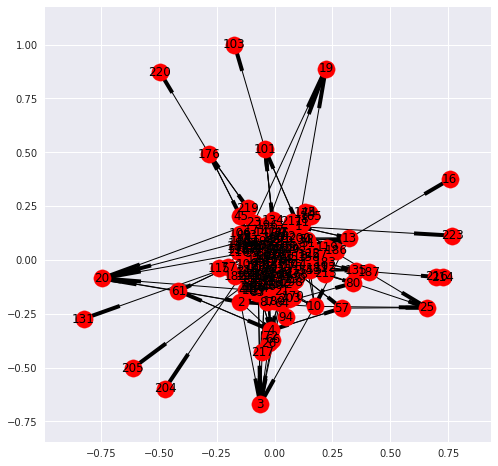





#nodes: 286
#edges: 1088
#edges/#nodes: 3.804195804195804


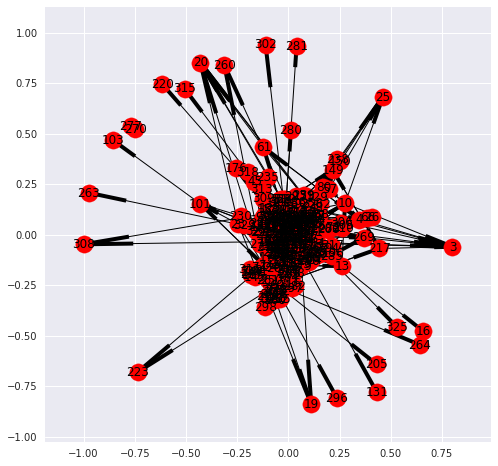





#nodes: 632
#edges: 2724
#edges/#nodes: 4.310126582278481


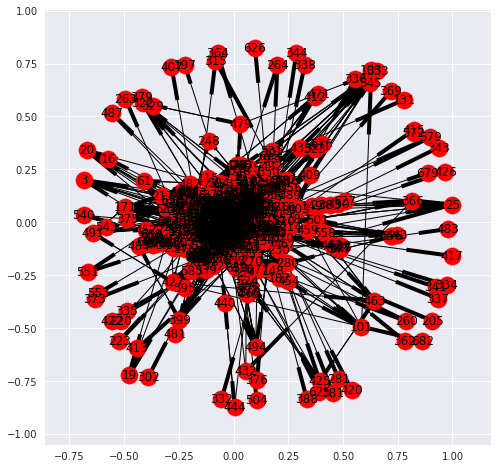





#nodes: 1153
#edges: 5160
#edges/#nodes: 4.475281873373808


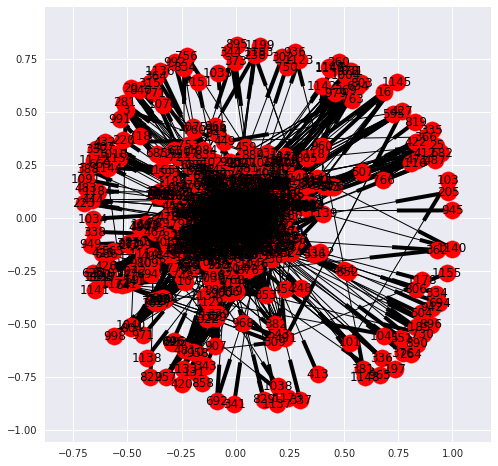





#nodes: 1297
#edges: 5937
#edges/#nodes: 4.577486507324595


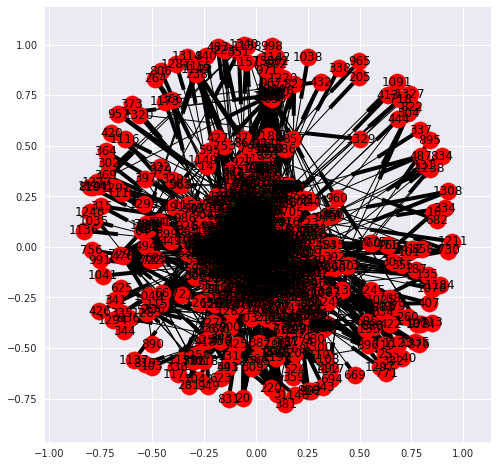





#nodes: 1379
#edges: 6414
#edges/#nodes: 4.651196519216824


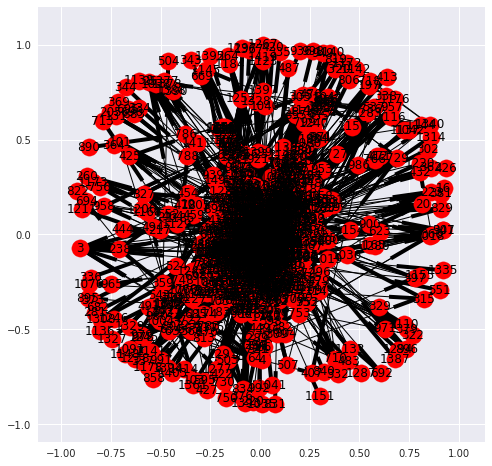





#nodes: 1430
#edges: 6756
#edges/#nodes: 4.724475524475524


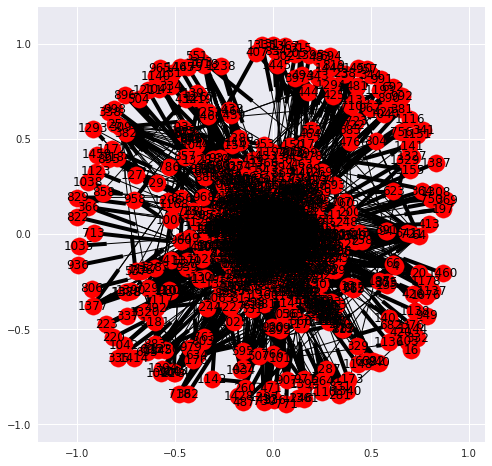





#nodes: 1466
#edges: 6989
#edges/#nodes: 4.767394270122783


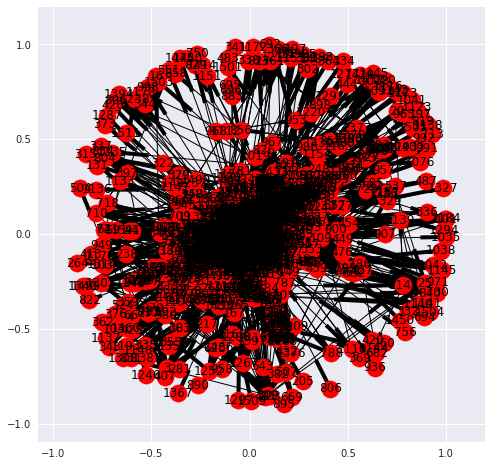





#nodes: 1511
#edges: 7227
#edges/#nodes: 4.782925215089345


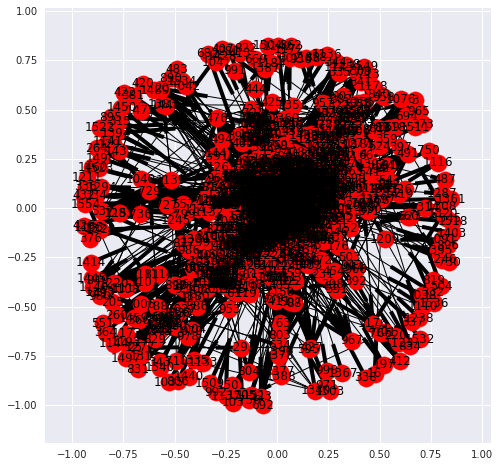





#nodes: 1574
#edges: 7530
#edges/#nodes: 4.783989834815756


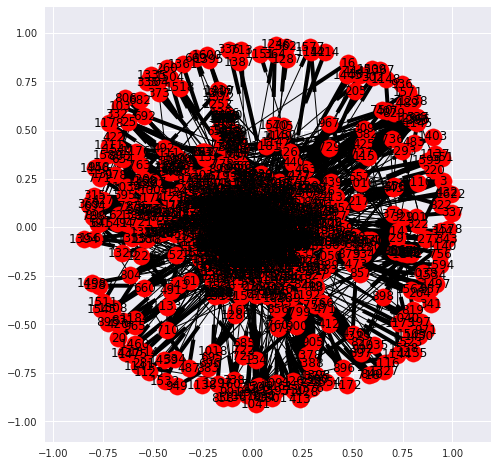





#nodes: 1640
#edges: 7923
#edges/#nodes: 4.83109756097561


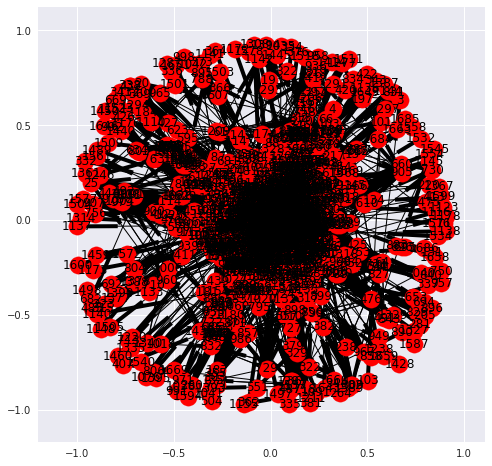





#nodes: 1699
#edges: 8269
#edges/#nodes: 4.866980576809889


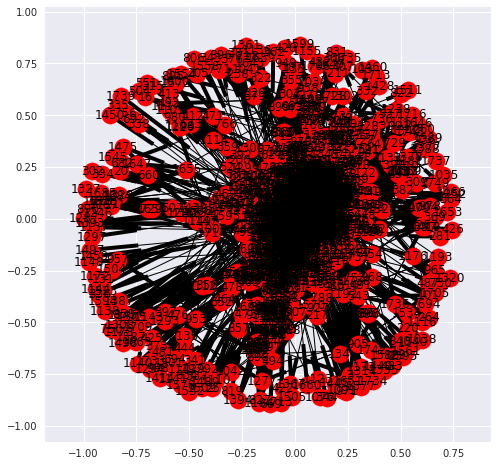





#nodes: 1772
#edges: 8745
#edges/#nodes: 4.9351015801354405


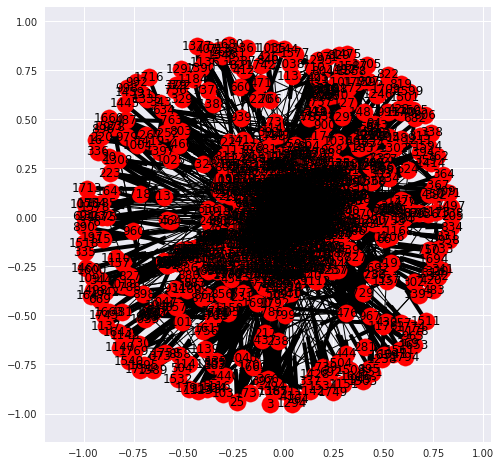





#nodes: 1863
#edges: 9260
#edges/#nodes: 4.970477724100912


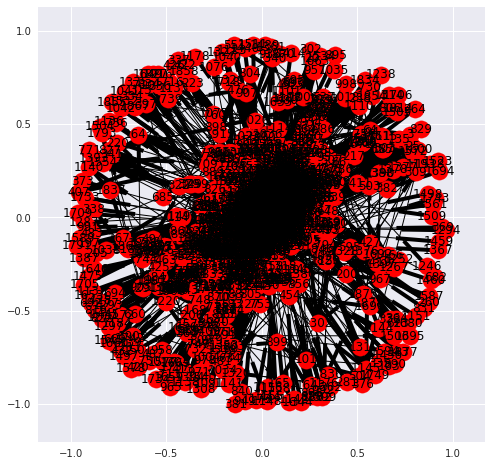





#nodes: 1944
#edges: 9765
#edges/#nodes: 5.023148148148148


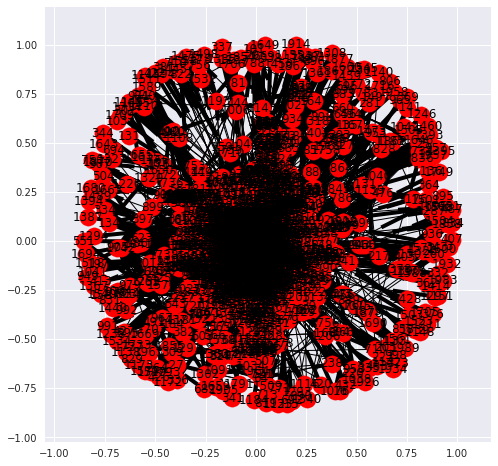





#nodes: 2029
#edges: 10261
#edges/#nodes: 5.057171020206998


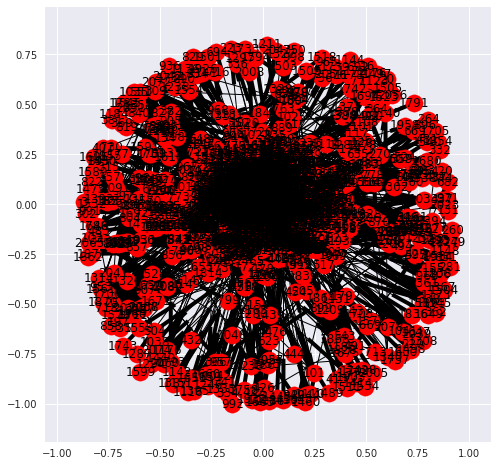





#nodes: 2136
#edges: 10965
#edges/#nodes: 5.133426966292135


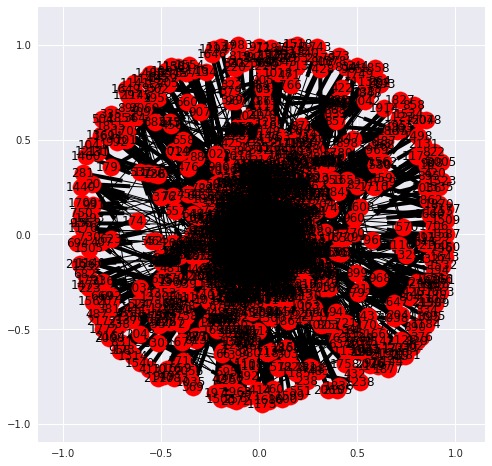





#nodes: 2248
#edges: 11730
#edges/#nodes: 5.217971530249111


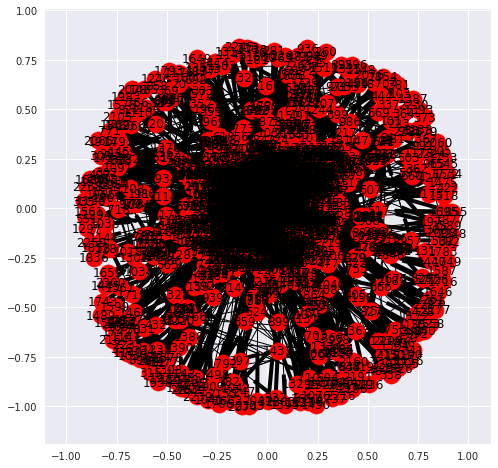





#nodes: 2351
#edges: 12524
#edges/#nodes: 5.327094853253935


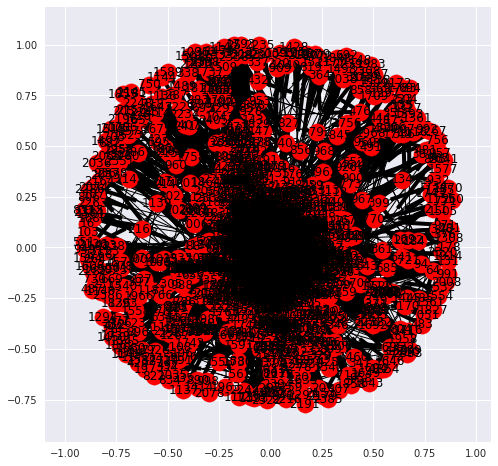





#nodes: 2504
#edges: 13446
#edges/#nodes: 5.369808306709265


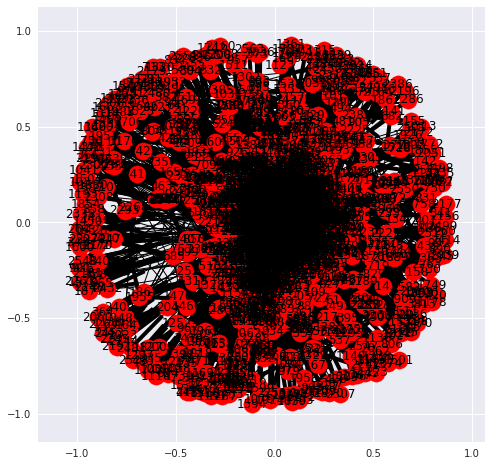





#nodes: 2691
#edges: 14550
#edges/#nodes: 5.406911928651059


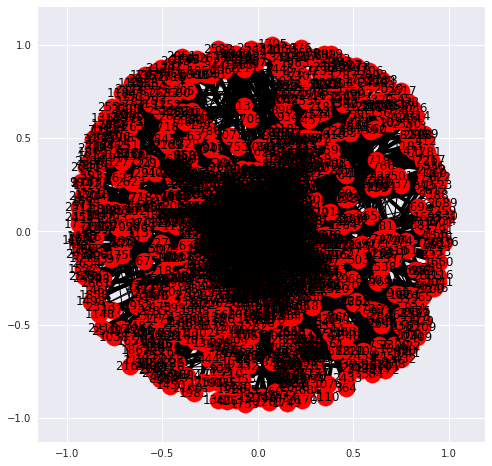





#nodes: 2857
#edges: 15477
#edges/#nodes: 5.417220861043052


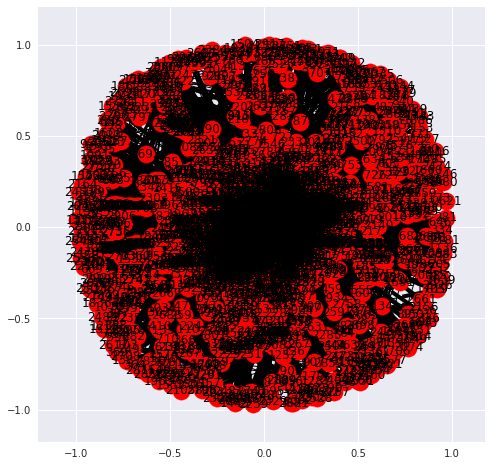





#nodes: 3010
#edges: 16410
#edges/#nodes: 5.451827242524917


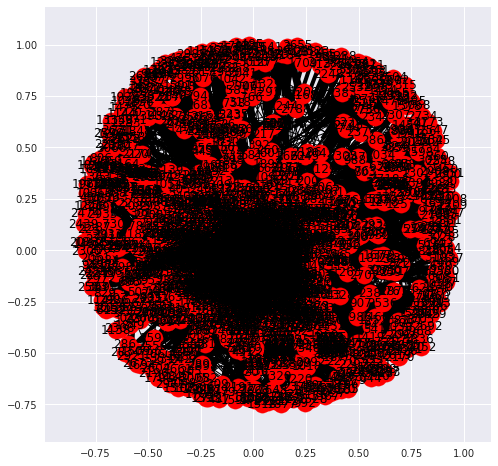





#nodes: 3160
#edges: 17320
#edges/#nodes: 5.481012658227848


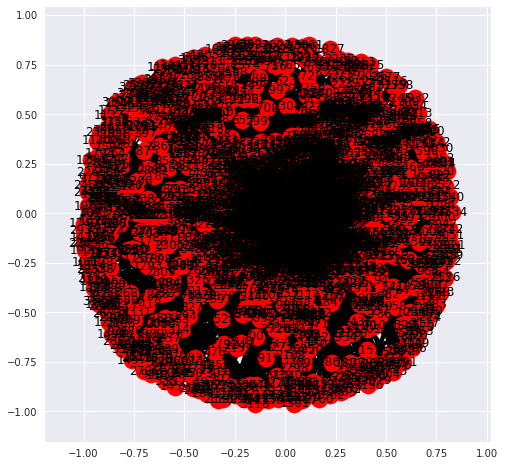





#nodes: 3296
#edges: 18123
#edges/#nodes: 5.498483009708738


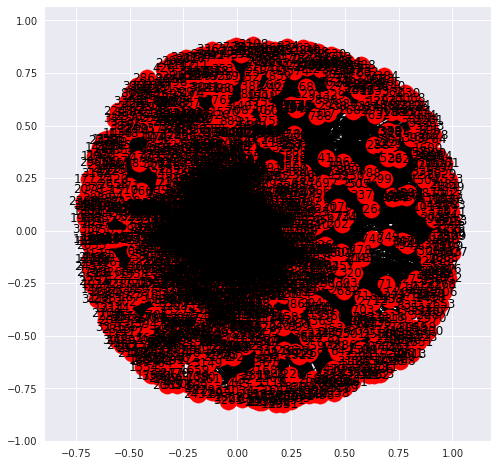





#nodes: 3430
#edges: 18880
#edges/#nodes: 5.504373177842566


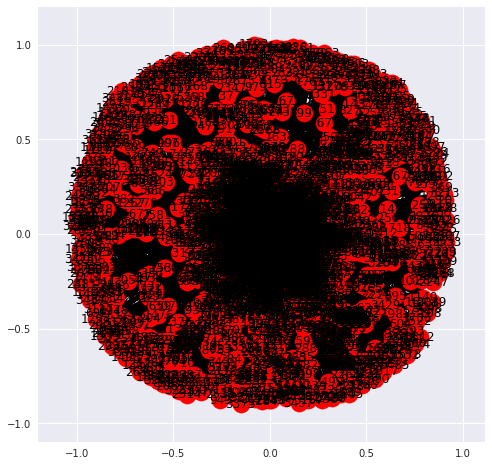





#nodes: 3652
#edges: 19962
#edges/#nodes: 5.466046002190581


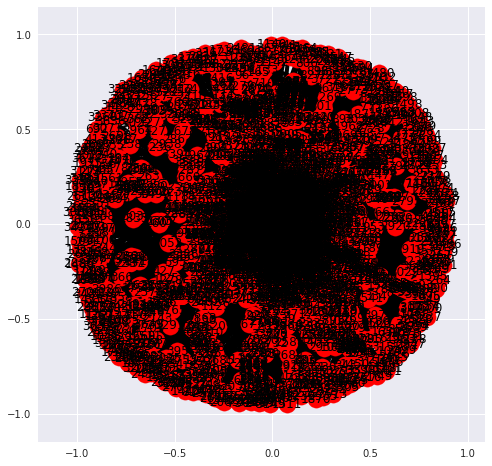





#nodes: 4024
#edges: 21863
#edges/#nodes: 5.433151093439363


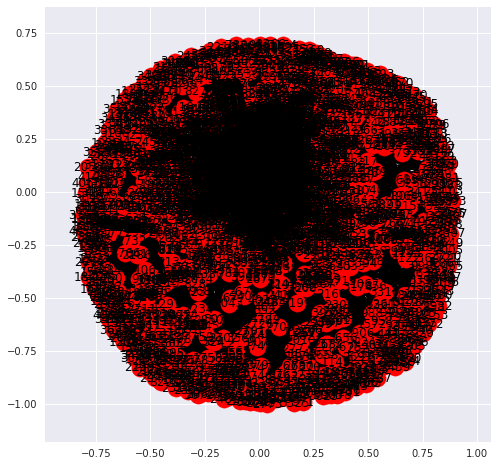





#nodes: 4179
#edges: 22983
#edges/#nodes: 5.499641062455133


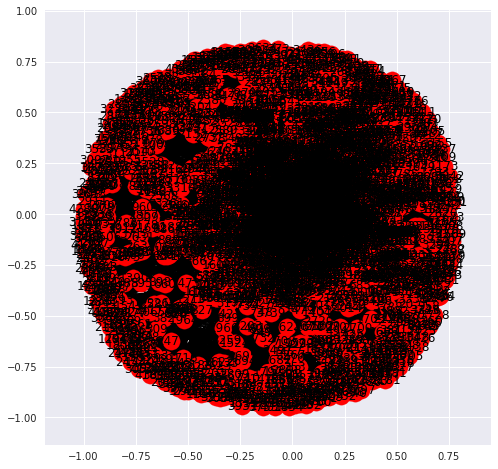





#nodes: 4309
#edges: 23894
#edges/#nodes: 5.5451380830819215


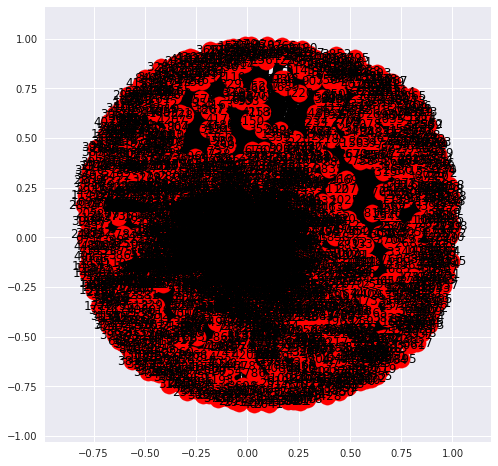





#nodes: 4433
#edges: 24749
#edges/#nodes: 5.582900969997744


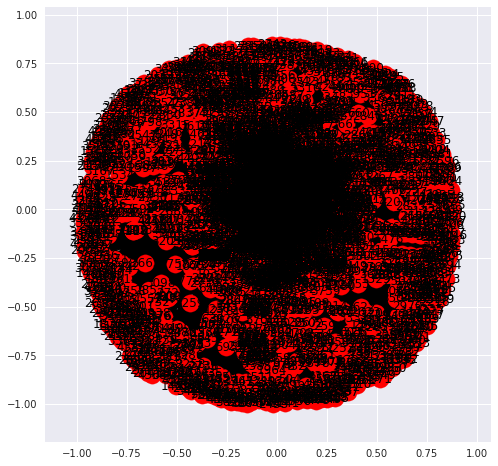





#nodes: 4584
#edges: 26077
#edges/#nodes: 5.68869982547993


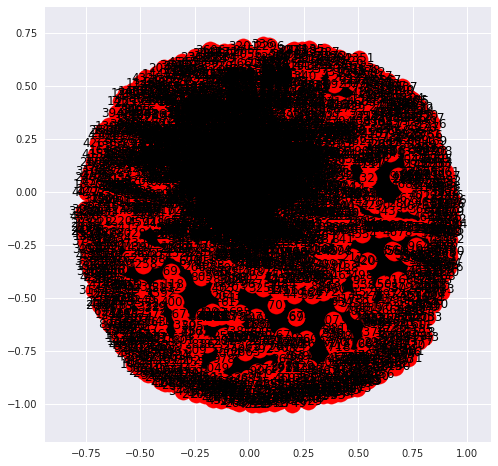





#nodes: 4746
#edges: 27565
#edges/#nodes: 5.808048883270122


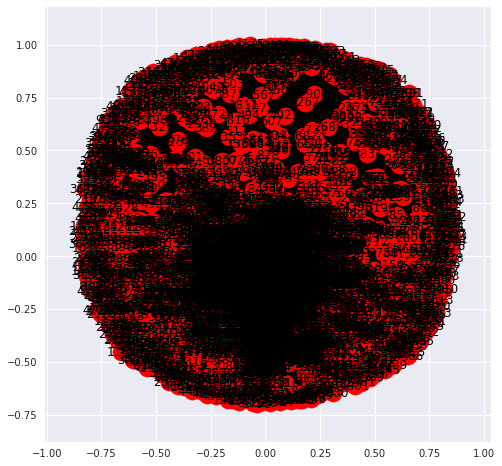





#nodes: 4798
#edges: 28091
#edges/#nodes: 5.854731137974156


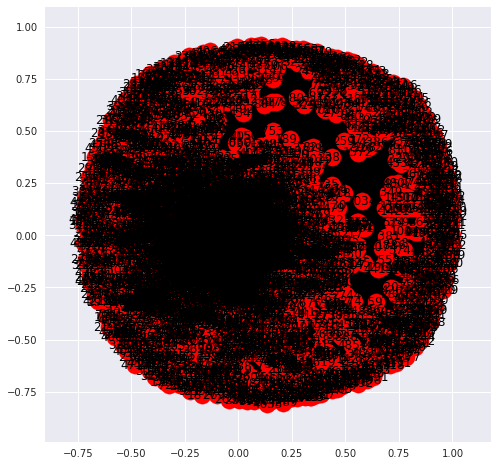





#nodes: 4887
#edges: 28646
#edges/#nodes: 5.8616738285246575


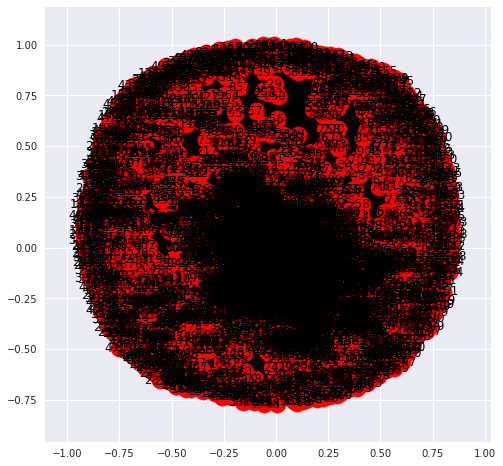





#nodes: 5018
#edges: 29571
#edges/#nodes: 5.89298525308888


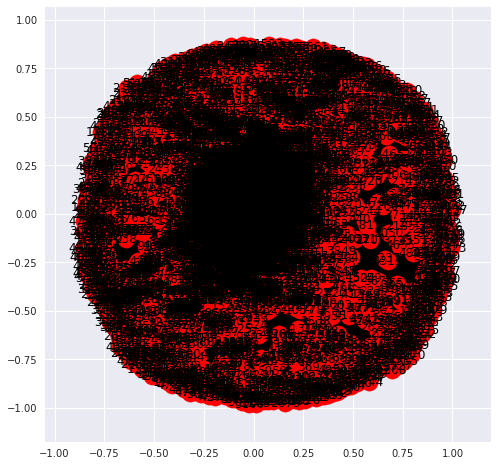





#nodes: 5156
#edges: 30286
#edges/#nodes: 5.873933281613654


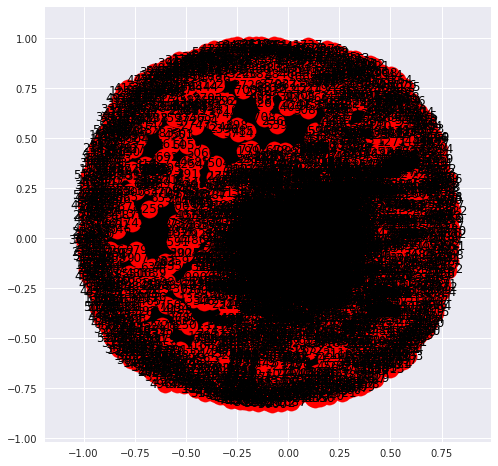





#nodes: 5237
#edges: 30716
#edges/#nodes: 5.865189994271529


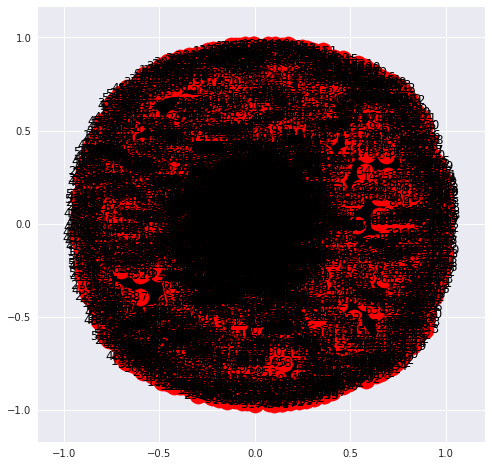





#nodes: 5334
#edges: 31209
#edges/#nodes: 5.85095613048369


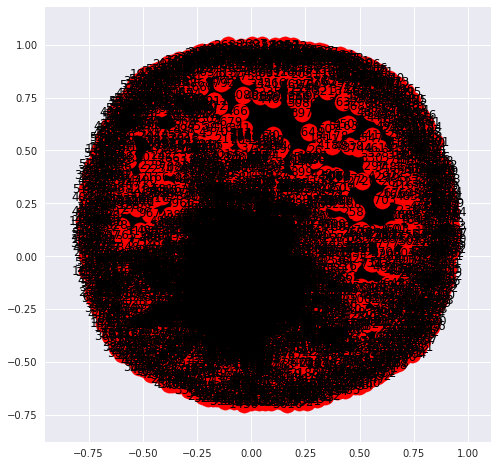





#nodes: 5374
#edges: 31530
#edges/#nodes: 5.867138072199479


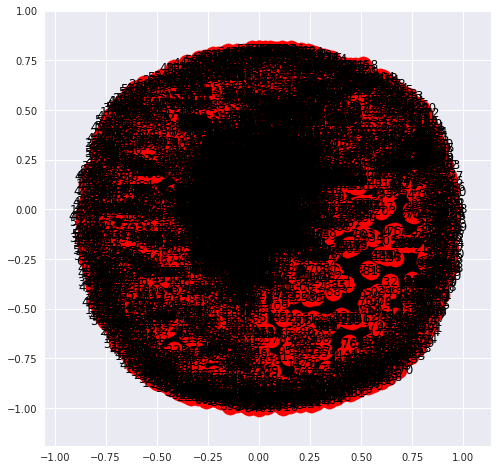





#nodes: 5431
#edges: 31954
#edges/#nodes: 5.883631007180998


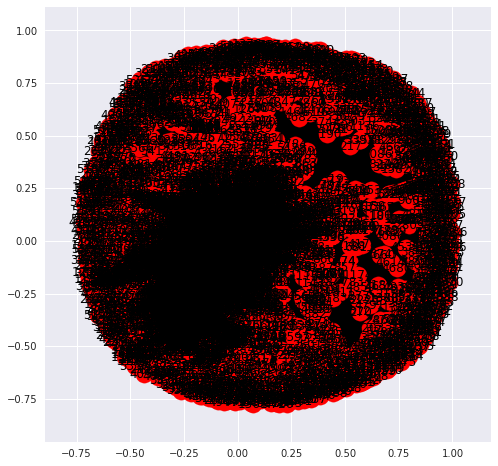





#nodes: 5478
#edges: 32393
#edges/#nodes: 5.913289521723256


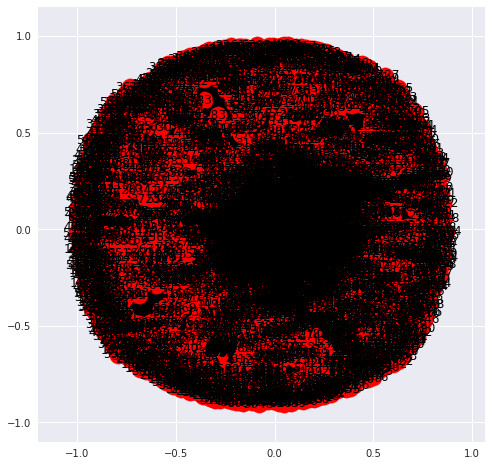





#nodes: 5518
#edges: 32727
#edges/#nodes: 5.930953243928959


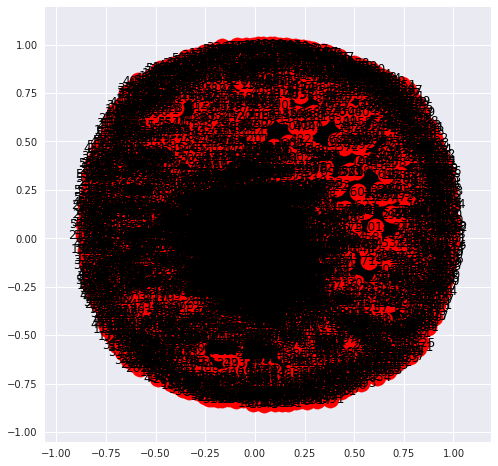





#nodes: 5573
#edges: 33085
#edges/#nodes: 5.936658891082002


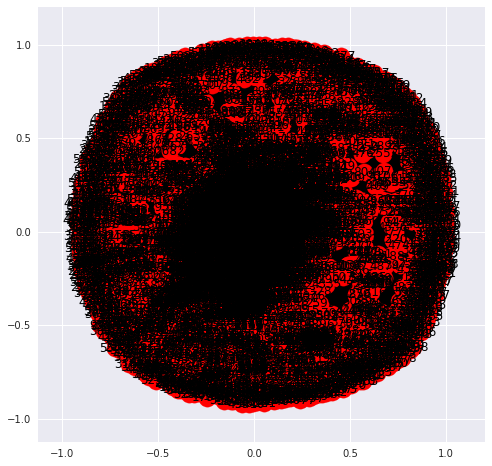





#nodes: 5605
#edges: 33399
#edges/#nodes: 5.95878679750223


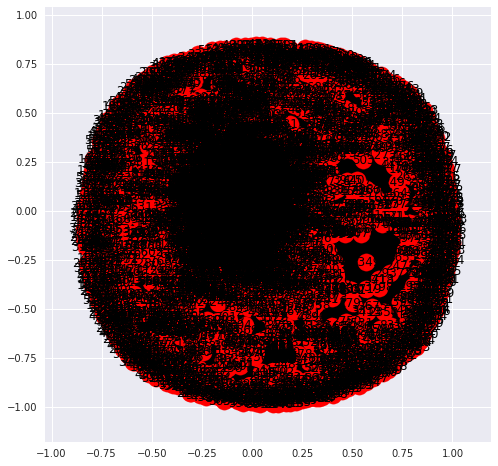





#nodes: 5661
#edges: 33760
#edges/#nodes: 5.963610669493023


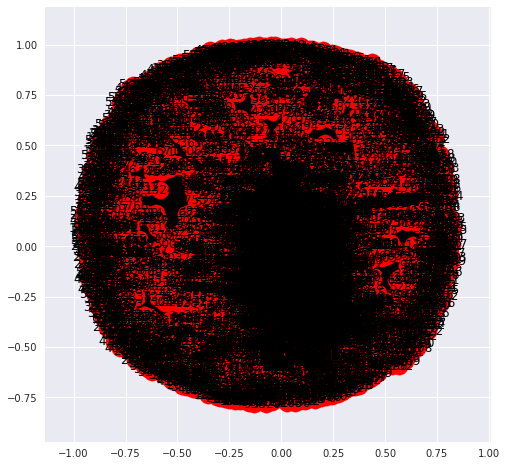





#nodes: 5684
#edges: 33953
#edges/#nodes: 5.973434201266714


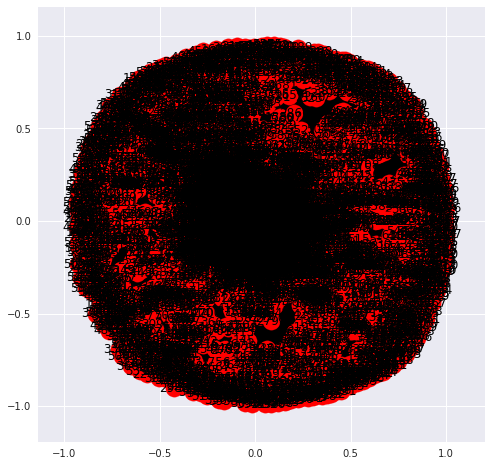





#nodes: 5710
#edges: 34165
#edges/#nodes: 5.983362521891419


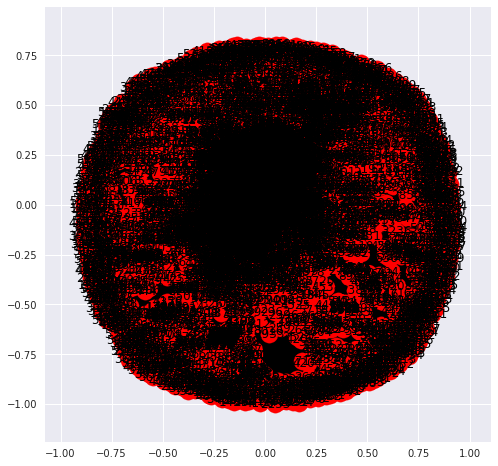





#nodes: 5731
#edges: 34363
#edges/#nodes: 5.995986738789042


KeyboardInterrupt: 

In [20]:
sns.set(rc={'figure.figsize':(8, 8)})
for accumulated_directed_graph in accumulated_directed_graphs:
    n = len(accumulated_directed_graph.nodes())
    e = len(accumulated_directed_graph.edges())
    print(
        '#nodes: {}\n#edges: {}\n#edges/#nodes: {}'
        .format(n, e, e/n))
    nx.draw_networkx(accumulated_directed_graph)
    plt.show()
    print('\n\n\n')

### Computing the metrics for networks in periods

In [242]:
sorted_keys = sorted(
    get_metrics_for_network(directed_graphs[0]).keys())

evolving_metrics = collections.defaultdict(list)
for index, directed_graph in enumerate(directed_graphs):
    print(index, '...')
    metrics = get_metrics_for_network(directed_graph)
    for key in sorted_keys:
        evolving_metrics[key].append(metrics[key])

0 ...
1 ...
2 ...
3 ...
4 ...
5 ...
6 ...
7 ...
8 ...
9 ...
10 ...
11 ...
12 ...
13 ...
14 ...
15 ...
16 ...
17 ...
18 ...
19 ...
20 ...
21 ...
22 ...
23 ...
24 ...
25 ...
26 ...
27 ...
28 ...
29 ...
30 ...
31 ...
32 ...
33 ...
34 ...
35 ...
36 ...
37 ...
38 ...
39 ...
40 ...
41 ...
42 ...
43 ...
44 ...
45 ...
46 ...
47 ...
48 ...
49 ...
50 ...
51 ...
52 ...
53 ...
54 ...
55 ...
56 ...
57 ...
58 ...
59 ...
60 ...
61 ...
62 ...
63 ...
64 ...
65 ...
66 ...


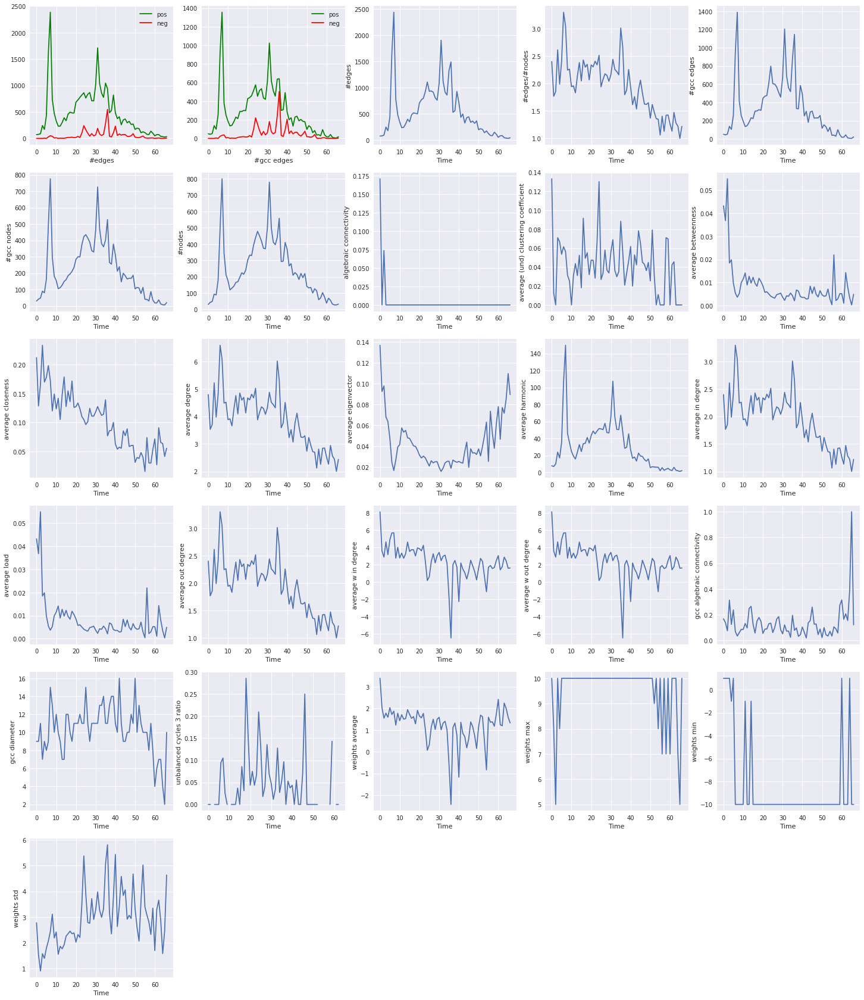

In [243]:
m = 6
n = 5
sns.set(rc={'figure.figsize':(25, 30)})

sorted_keys = sorted(list(
    set(evolving_metrics.keys()) - set([
        '#pos edges', '#neg edges', '#gcc pos edges', '#gcc neg edges'])))

plt.subplot(m, n, 1)
plt.plot(evolving_metrics['#pos edges'], 'g')
plt.plot(evolving_metrics['#neg edges'], 'r')
plt.xlabel('#edges')
plt.legend(['pos', 'neg'])

plt.subplot(m, n, 2)
plt.plot(evolving_metrics['#gcc pos edges'], 'g')
plt.plot(evolving_metrics['#gcc neg edges'], 'r')
plt.xlabel('#gcc edges')
plt.legend(['pos', 'neg'])

for index, key in enumerate(sorted_keys):
    plt.subplot(m, n, index+3)
    plt.plot(evolving_metrics[key])
    plt.ylabel(key)
    plt.xlabel('Time')

### Computing the metrics for accumulative networks in periods

In [252]:
sorted_keys = sorted(
    get_metrics_for_network(accumulated_directed_graphs[0]).keys())

accumulative_evolving_metrics = collections.defaultdict(list)
for index, accumulated_directed_graph in enumerate(accumulated_directed_graphs):
    print(index, '...')
    metrics = get_metrics_for_network(accumulated_directed_graph)
    for key in sorted_keys:
        accumulative_evolving_metrics[key].append(metrics[key])

0 ...
1 ...
2 ...
3 ...
4 ...
5 ...
6 ...
7 ...
8 ...
9 ...
10 ...
11 ...
12 ...
13 ...
14 ...
15 ...
16 ...
17 ...
18 ...
19 ...
20 ...
21 ...
22 ...
23 ...
24 ...
25 ...
26 ...
27 ...
28 ...
29 ...
30 ...
31 ...
32 ...
33 ...
34 ...
35 ...
36 ...
37 ...
38 ...
39 ...
40 ...
41 ...
42 ...
43 ...
44 ...
45 ...
46 ...
47 ...
48 ...
49 ...
50 ...
51 ...
52 ...
53 ...
54 ...
55 ...
56 ...
57 ...
58 ...
59 ...
60 ...
61 ...
62 ...
63 ...
64 ...
65 ...
66 ...


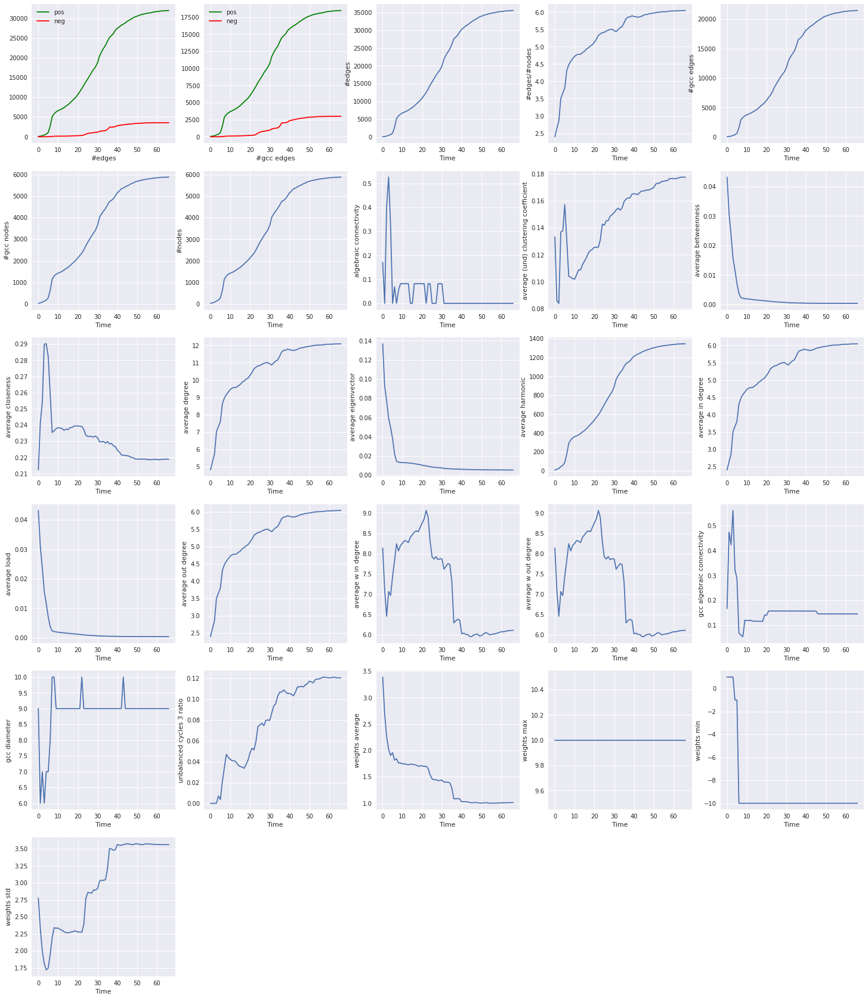

In [253]:
m = 6
n = 5
sns.set(rc={'figure.figsize':(25, 30)})

sorted_keys = sorted(list(
    set(accumulative_evolving_metrics.keys()) - set([
        '#pos edges', '#neg edges', '#gcc pos edges', '#gcc neg edges'])))

plt.subplot(m, n, 1)
plt.plot(accumulative_evolving_metrics['#pos edges'], 'g')
plt.plot(accumulative_evolving_metrics['#neg edges'], 'r')
plt.xlabel('#edges')
plt.legend(['pos', 'neg'])

plt.subplot(m, n, 2)
plt.plot(accumulative_evolving_metrics['#gcc pos edges'], 'g')
plt.plot(accumulative_evolving_metrics['#gcc neg edges'], 'r')
plt.xlabel('#gcc edges')
plt.legend(['pos', 'neg'])

for index, key in enumerate(sorted_keys):
    plt.subplot(m, n, index+3)
    plt.plot(accumulative_evolving_metrics[key])
    plt.ylabel(key)
    plt.xlabel('Time')

### Edges with double different signs 

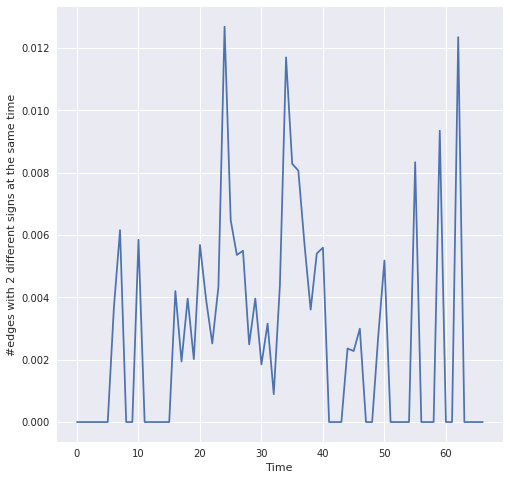

In [254]:
sns.set(rc={'figure.figsize':(8, 8)})
different_signed_edges = []
for directed_graph in directed_graphs:    
    different_signed_edges.append(
        count_different_signed_edges(directed_graph) / len(directed_graph.edges()))
plt.plot(different_signed_edges)
plt.xlabel('Time')
plt.ylabel('#edges with 2 different signs at the same time');

# Van de Rijt balance

In [15]:
edge_balances = []
for directed_graph in directed_graphs:
    edge_balances.append(compute_edge_balance(directed_graph))

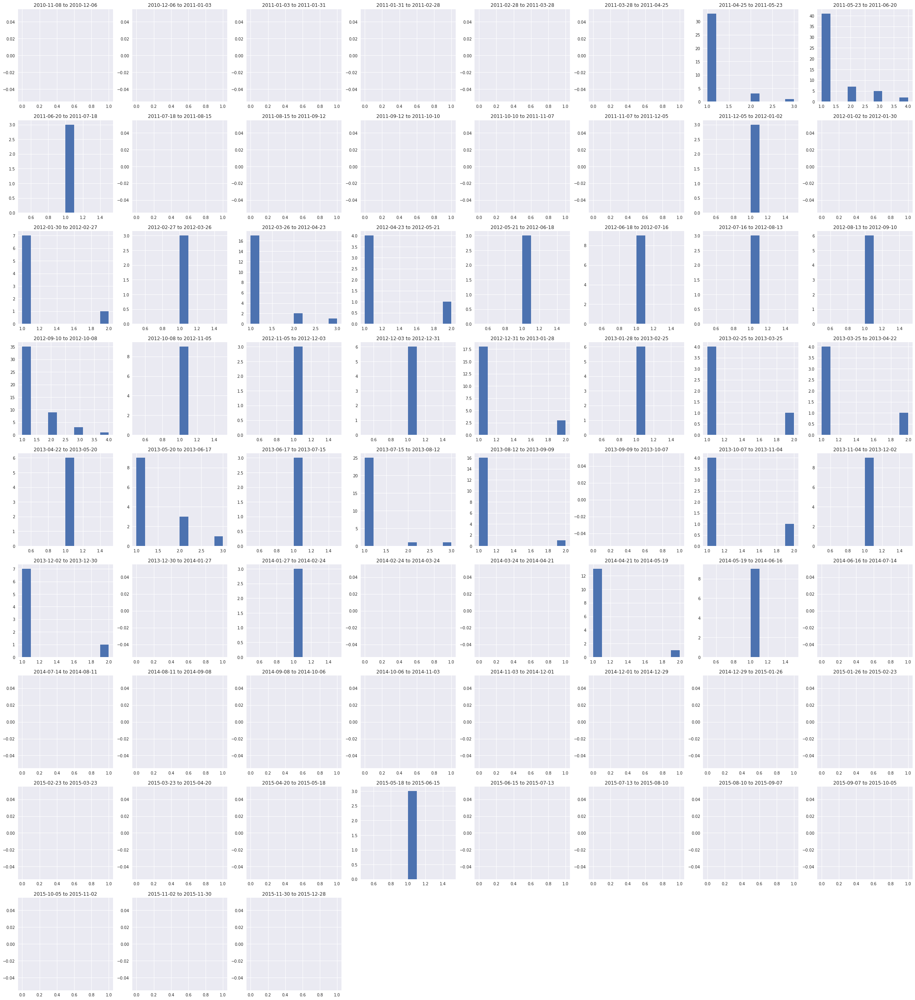

In [21]:
m = 9
n = 8
sns.set(rc={'figure.figsize':(40, 45)})
for index, edge_balance in enumerate(edge_balances):
    num_unbalanced = []
    for value in edge_balance.values():
        num_unbalanced.append(
            value['#cycle3'] - value['#balanced'])
    plt.subplot(m, n, index + 1)
    if num_unbalanced:
        num_unbalanced = np.array(num_unbalanced)
        num_unbalanced = num_unbalanced[num_unbalanced.nonzero()]
    plt.hist(num_unbalanced)
    
    # Period.
    period_start = (
        start_date + index * datetime.timedelta(weeks * 7))
    period_end = period_start + datetime.timedelta(weeks * 7)
    plt.title(
        '{} to {}'.format(str(period_start).split(' ')[0],
                          str(period_end).split(' ')[0]))

### Accumulated

In [22]:
accumulated_edge_balances = []
for accumulated_directed_graph in accumulated_directed_graphs:
    accumulated_edge_balances.append(compute_edge_balance(accumulated_directed_graph))

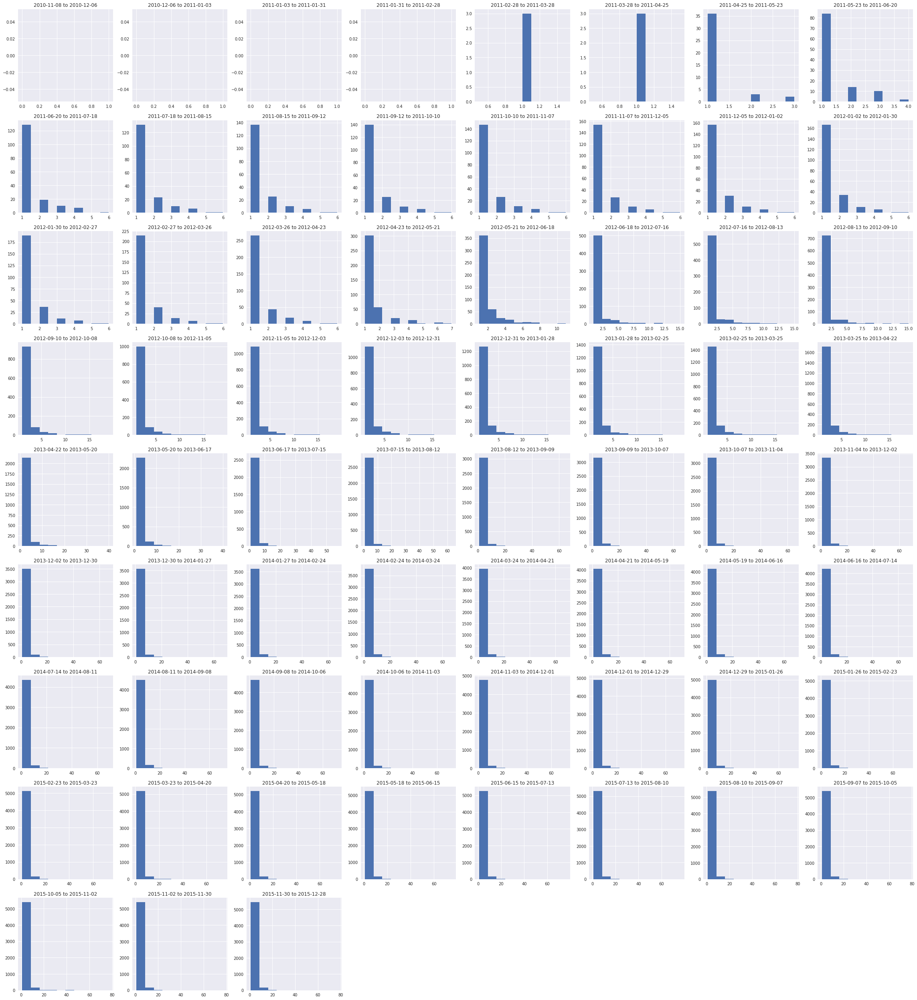

In [25]:
m = 9
n = 8
sns.set(rc={'figure.figsize':(40, 45)})
for index, accumulated_edge_balance in enumerate(accumulated_edge_balances):
    num_unbalanced = []
    for value in accumulated_edge_balance.values():
        num_unbalanced.append(
            value['#cycle3'] - value['#balanced'])
    plt.subplot(m, n, index + 1)
    if num_unbalanced:
        num_unbalanced = np.array(num_unbalanced)
        num_unbalanced = num_unbalanced[num_unbalanced.nonzero()]
    plt.hist(num_unbalanced)
    
    # Period.
    period_start = (
        start_date + index * datetime.timedelta(weeks * 7))
    period_end = period_start + datetime.timedelta(weeks * 7)
    plt.title(
        '{} to {}'.format(str(period_start).split(' ')[0],
                          str(period_end).split(' ')[0]))

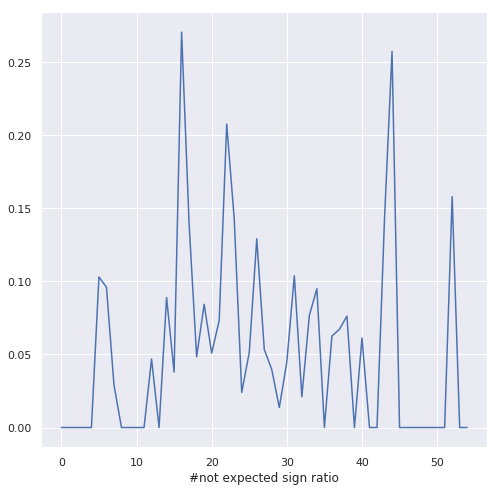

In [21]:
sns.set(rc={'figure.figsize':(8, 8)})
ratios = []
for edge_balance in edge_balances:
    expected = 0
    for value in edge_balance.values():
        if value['as_expected_sign']:
            expected += 1
    if edge_balance:
        ratios.append( expected / len(edge_balance) )

plt.plot(1-np.array(ratios))
plt.xlabel('#not expected sign ratio');

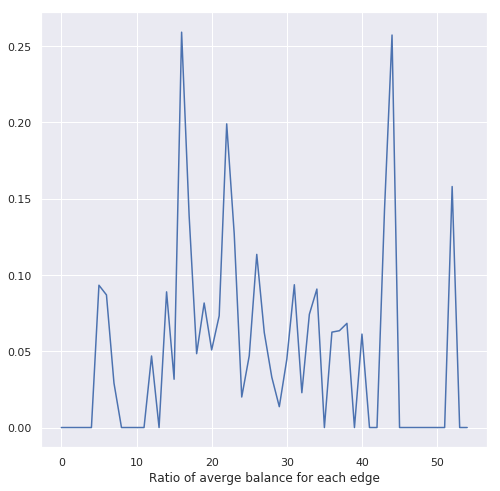

In [20]:
balanced_ratios = []
for edge_balance in edge_balances:
    balanced_ratio = 0
    for value in edge_balance.values():
        balanced_ratio += value['#balanced']/value['#cycle3']
    if edge_balance:
        balanced_ratios.append( balanced_ratio / len(edge_balance) )

plt.plot(1-np.array(balanced_ratios))
plt.xlabel('Ratio of averge balance for each edge');

### Cartwright & Harary balance

In [56]:
for directed_graph in directed_graphs:
    print('cartwright & harary unbalance ratio: ',
          cartwright_harary_balance(directed_graph))

cartwright & harary unbalance ratio:  1.0
cartwright & harary unbalance ratio:  1.0
cartwright & harary unbalance ratio:  1.0
cartwright & harary unbalance ratio:  1.0
cartwright & harary unbalance ratio:  1.0


KeyboardInterrupt: 